# Wind Farm Spotter: Training Evaluation
Visualizing activations with PyTorch Hooks/Fast.ai Callbacks

### **Environment Setup**

In [0]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [0]:
!pip install pytorchcv

In [0]:
from google.colab import drive
drive.mount('/content/drive')

In [0]:
import fastai
from fastai.vision import *
from pytorchcv.model_provider import get_model as ptcv_get_model
import torch
import warnings
warnings.filterwarnings('ignore')

In [0]:
path = Path("/content/drive/My Drive/dla-project/data/")
#path.ls()

### **Evaluating Transfer Learning with EfficientNet-b1** 

#### **Data Loaders**

First we'll regenerate training data to reinstate the different phases of training.

In [0]:
bs = 32 
tfms = ([crop_pad()], [])

#EfficientNet sizes 
eff_size1 = 256
eff_size2 = 288
eff_size3 = 304
eff_size4 = 320

#InceptionV3 sizes
inc_size1 = 299
inc_size2 = 315
inc_size3 = 331
inc_size4 = 347
inc_size5 = 363

In [0]:
#ImageLists
eff_src1 = ImageList.from_folder(path/'train').split_by_rand_pct().label_from_folder().transform(tfms, size=eff_size1)   
eff_src2 = ImageList.from_folder(path/'train').split_by_rand_pct().label_from_folder().transform(tfms, size=eff_size2) 
eff_src3 = ImageList.from_folder(path/'train').split_by_rand_pct().label_from_folder().transform(tfms, size=eff_size3)
eff_src4 = ImageList.from_folder(path/'train').split_by_rand_pct().label_from_folder().transform(tfms, size=eff_size4) 

inc_src1 = ImageList.from_folder(path/'train').split_by_rand_pct().label_from_folder().transform(tfms, size=inc_size1)   
inc_src2 = ImageList.from_folder(path/'train').split_by_rand_pct().label_from_folder().transform(tfms, size=inc_size2) 
inc_src3 = ImageList.from_folder(path/'train').split_by_rand_pct().label_from_folder().transform(tfms, size=inc_size3)  
inc_src4 = ImageList.from_folder(path/'train').split_by_rand_pct().label_from_folder().transform(tfms, size=inc_size4) 
inc_src5 = ImageList.from_folder(path/'train').split_by_rand_pct().label_from_folder().transform(tfms, size=inc_size5)


In [0]:
#Data Loaders
np.random.seed(74)
eff_data1 = (eff_src1).databunch(bs=bs).normalize(imagenet_stats)
eff_data2 = (eff_src2).databunch(bs=bs).normalize(imagenet_stats)
eff_data3 = (eff_src3).databunch(bs=bs).normalize(imagenet_stats)
eff_data4 = (eff_src4).databunch(bs=bs).normalize(imagenet_stats)

inc_data1 = (inc_src1).databunch(bs=bs).normalize(imagenet_stats)
inc_data2 = (inc_src2).databunch(bs=bs).normalize(imagenet_stats)
inc_data3 = (inc_src3).databunch(bs=bs).normalize(imagenet_stats)
inc_data4 = (inc_src4).databunch(bs=bs).normalize(imagenet_stats)
inc_data5 = (inc_src5).databunch(bs=bs).normalize(imagenet_stats)


### **Creating Forward Pass Hooks**

In [0]:
from fastai.callbacks import HookCallback

#### **Define the Hook**

In [0]:
# Modified from: https://forums.fast.ai/t/confused-by-output-of-hook-output/29514/4
class StoreHook(HookCallback):
    def on_train_begin(self, **kwargs):
        super().on_train_begin(**kwargs)
        self.hists = []
        
    def hook(self, m, i, o): 
        return o
    
    def on_batch_end(self, train, **kwargs): 
        if (train): 
            self.hists.append(self.hooks.stored[0].cpu().histc(40,0,10))

#### **Hook Helpers**

In [0]:
# Simply pass in a learner and the module you would like to instrument
def probeModule(learn, module):
    hook = StoreHook(learn, modules=flatten_model(module))
    learn.callbacks += [ hook ]
    return hook

In [0]:
# Thanks to @ste for initial version of histgram plotting code
def get_hist(h): 
    return torch.stack(h.hists).t().float().log1p()

In [0]:
def plot_activations(hooks, names, num_layers):
  fig,axes = plt.subplots(8, figsize=(15,10))
  for i, (ax,h) in enumerate(zip(axes.flatten(), hooks)):
    ax.imshow(get_hist(h), origin='lower', aspect='auto')
    ax.axis('off')
    ax.text(0, -num_layers, names[i], bbox={'facecolor':'red', 'alpha':0.0, 'pad':10})
    plt.tight_layout()

### **Redefine the Architecture for Module Inspection**

#### **Pre-Trained EfficientNet-b1**

In [0]:
def efficientnet_b1(pretrained=True):
    return ptcv_get_model("efficientnet_b1", pretrained=pretrained).features

#### **Fast.ai Learner for EfficientNet**

In [15]:
#Fastai Learner (Model with built-in Training Tools)
eff_learn = cnn_learner(eff_data1, efficientnet_b1, pretrained=True, cut=noop, split_on=lambda m: (m[0][4], m[1]), metrics=[error_rate, accuracy])

In [52]:
#First Conv Block (Init)
print(eff_learn.model.children)

<bound method Module.children of Sequential(
  (0): Sequential(
    (init_block): EffiInitBlock(
      (conv): ConvBlock(
        (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (activ): Swish()
      )
    )
    (stage1): Sequential(
      (unit1): EffiDwsConvUnit(
        (dw_conv): ConvBlock(
          (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (activ): Swish()
        )
        (se): SEBlock(
          (pool): AdaptiveAvgPool2d(output_size=1)
          (conv1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
          (activ): Swish()
          (conv2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
          (sigmoid): Sigmoid()
        )
        (pw_conv): ConvBlock(
          (conv)

#### **Setup Hooks**

In [0]:
#Hook the output of the init_block and each effnet block
effnet_hooks = [
                probeModule(eff_learn, eff_learn.model[0][0]),
                probeModule(eff_learn, eff_learn.model[0][1][1]),
                probeModule(eff_learn, eff_learn.model[0][2][2]),
                probeModule(eff_learn, eff_learn.model[0][3][2]),
                probeModule(eff_learn, eff_learn.model[0][4][7]),
                probeModule(eff_learn, eff_learn.model[0][5][6]),
                probeModule(eff_learn, eff_learn.model[0][6]),
                probeModule(eff_learn, eff_learn.model[0][7])
                ]

#layer names
effnet_names = [
                'init_block',
                'stage1 - final conv unit',
                'stage2 - final conv unit',
                'stage3 - final conv unit',
                'stage4 - final conv unit', 
                'stage5 - final conv unit', 
                'final_block - swish act',
                'final_pool - adaptive avg pool'
                ]


### **Evaluating Training and Activations for EfficientNet**

#### **Stage 1:**

In [0]:
#Save .pth File  
eff_learn.load('wfs-effnet-v4-phase1')

In [39]:
eff_learn.fit_one_cycle(1, 4e-2, wd=2e-2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.057845,1.081791,0.368182,0.631818,07:16


In [0]:
eff_preds1, eff_y1, eff_losses1 = eff_learn.get_preds(with_loss=True)
eff_interp1 = ClassificationInterpretation(eff_learn, eff_preds1, eff_y1, eff_losses1)

In [0]:
accuracy(*eff_learn.TTA())

tensor(0.6273)

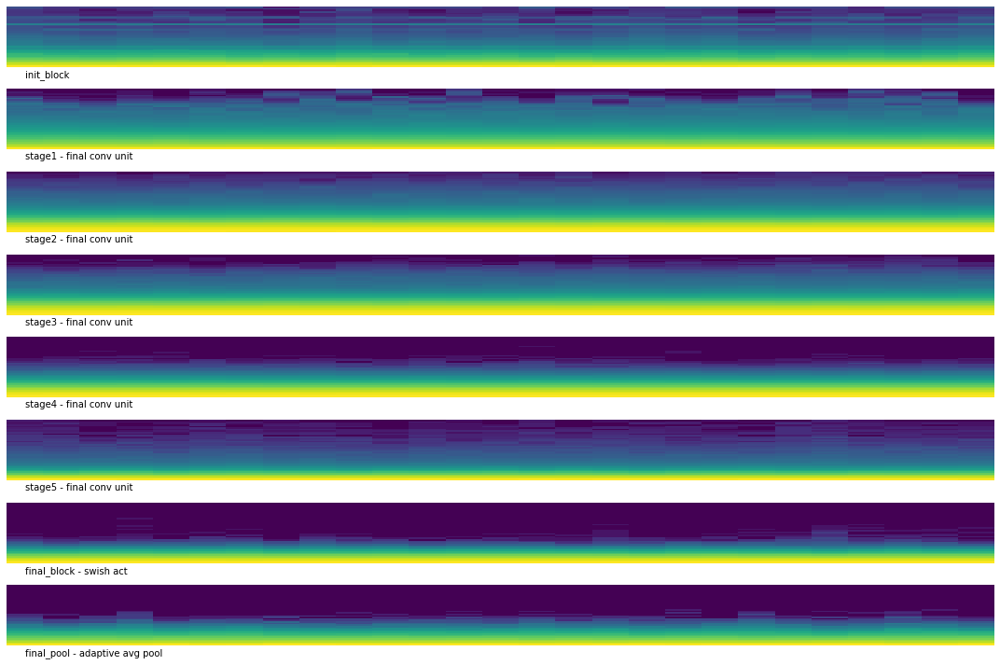

In [41]:
plot_activations(effnet_hooks, effnet_names, 7)

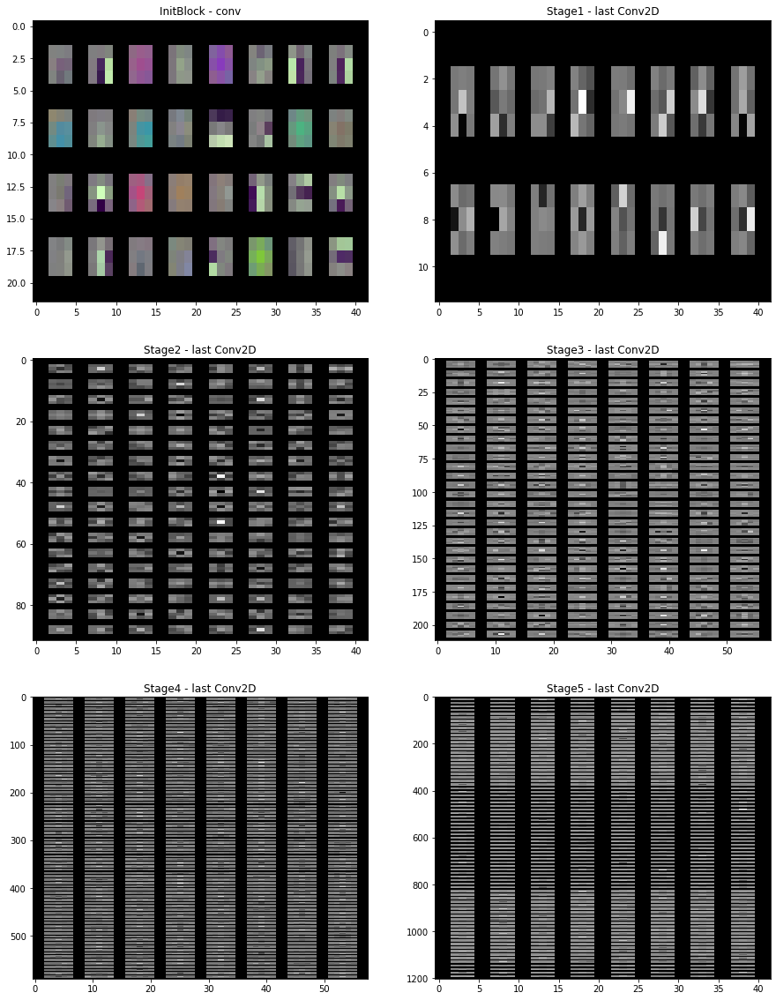

In [105]:
from torchvision.utils import make_grid

#https://discuss.pytorch.org/t/visualize-feature-map/29597/7
kernels1 = eff_learn.model[0][0].conv.conv.weight.detach().clone()
kernels1 = kernels1 - kernels1.min()
kernels1 = kernels1 / kernels1.max()
img1 = make_grid(kernels1)
#plt.imshow(img.permute(1, 2, 0))

kernels2  = eff_learn.model[0][1][1].dw_conv.conv.weight.detach().clone()
kernels2 = kernels2 - kernels2.min()
kernels2 = kernels2 / kernels2.max()
img2 = make_grid(kernels2)
#plt.imshow(img2.permute(1, 2, 1))

kernels3  = eff_learn.model[0][2][2].conv2.conv.weight.detach().clone()
kernels3 = kernels3 - kernels3.min()
kernels3 = kernels3 / kernels3.max()
img3 = make_grid(kernels3)
#plt.imshow(img3.permute(1, 2, 1))

kernels4  = eff_learn.model[0][3][2].conv2.conv.weight.detach().clone()
kernels4 = kernels4 - kernels4.min()
kernels4 = kernels4 / kernels4.max()
img4 = make_grid(kernels4)

kernels5  = eff_learn.model[0][4][7].conv2.conv.weight.detach().clone()
kernels5 = kernels5 - kernels5.min()
kernels5 = kernels5 / kernels5.max()
img5 = make_grid(kernels5)

kernels6  = eff_learn.model[0][5][6].conv2.conv.weight.detach().clone()
kernels6 = kernels6 - kernels6.min()
kernels6 = kernels6 / kernels6.max()
img6 = make_grid(kernels6)

fig, (axarr1, axarr2, axarr3) = plt.subplots(3,2, figsize=(15, 30))
axarr1[0].imshow(img1.permute(1, 2, 0), interpolation='nearest', aspect='auto')
axarr1[0].title.set_text('InitBlock - conv')
axarr1[1].imshow(img2.permute(1, 2, 0), interpolation='nearest', aspect='auto')
axarr1[1].title.set_text('Stage1 - last Conv2D')
axarr2[0].imshow(img3.permute(1, 2, 0), interpolation='nearest', aspect='auto')
axarr2[0].title.set_text('Stage2 - last Conv2D')
axarr2[1].imshow(img4.permute(1, 2, 0), interpolation='nearest', aspect='auto')
axarr2[1].title.set_text('Stage3 - last Conv2D')
axarr3[0].imshow(img5.permute(1, 2, 0), interpolation='nearest', aspect='auto')
axarr3[0].title.set_text('Stage4 - last Conv2D')
axarr3[1].imshow(img6.permute(1, 2, 0), interpolation='nearest', aspect='auto')
axarr3[1].title.set_text('Stage5 - last Conv2D')


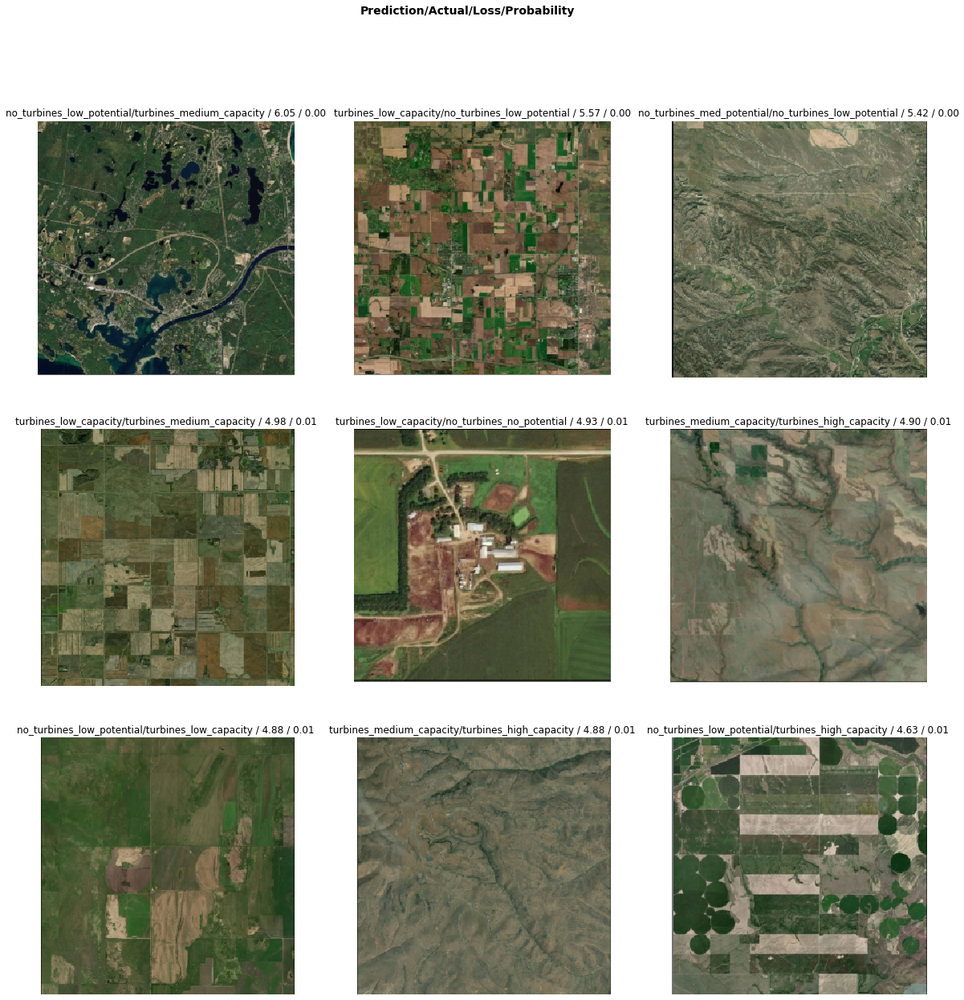

In [106]:
eff_interp1.plot_top_losses(9, figsize=(20, 20))

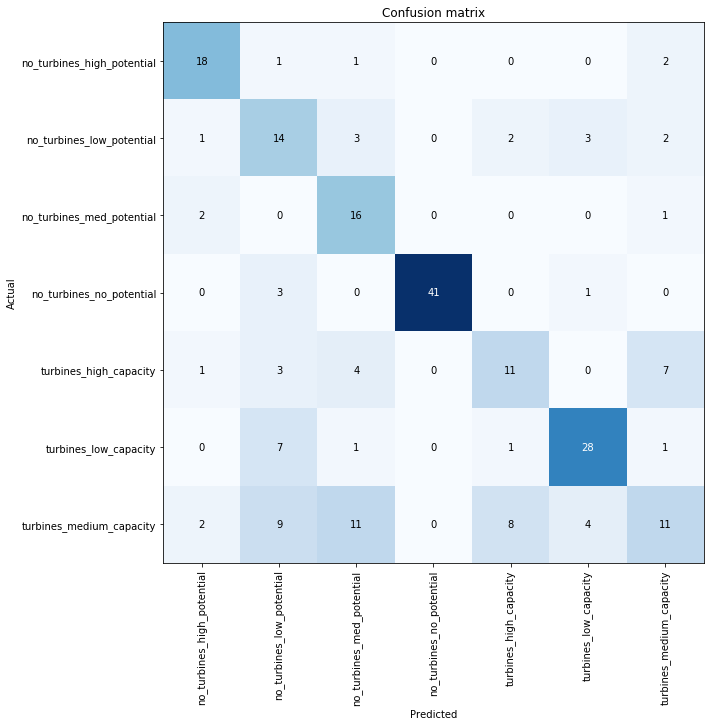

In [107]:
eff_interp1.plot_confusion_matrix(figsize=(10, 10))

#### **Stage 2:**

In [0]:
eff_learn.load('wfs-effnet-v4-phase2').unfreeze()
eff_learn.data = eff_data2 

In [109]:
eff_learn.fit_one_cycle(1, (4e-5,4e-4,4e-4), wd=2e-2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.519685,0.519987,0.159091,0.840909,03:58


In [0]:
eff_preds2, eff_y2, eff_losses2 = eff_learn.get_preds(with_loss=True)
eff_interp2 = ClassificationInterpretation(eff_learn, eff_preds2, eff_y2, eff_losses2)
#accuracy(*eff_learn.TTA())

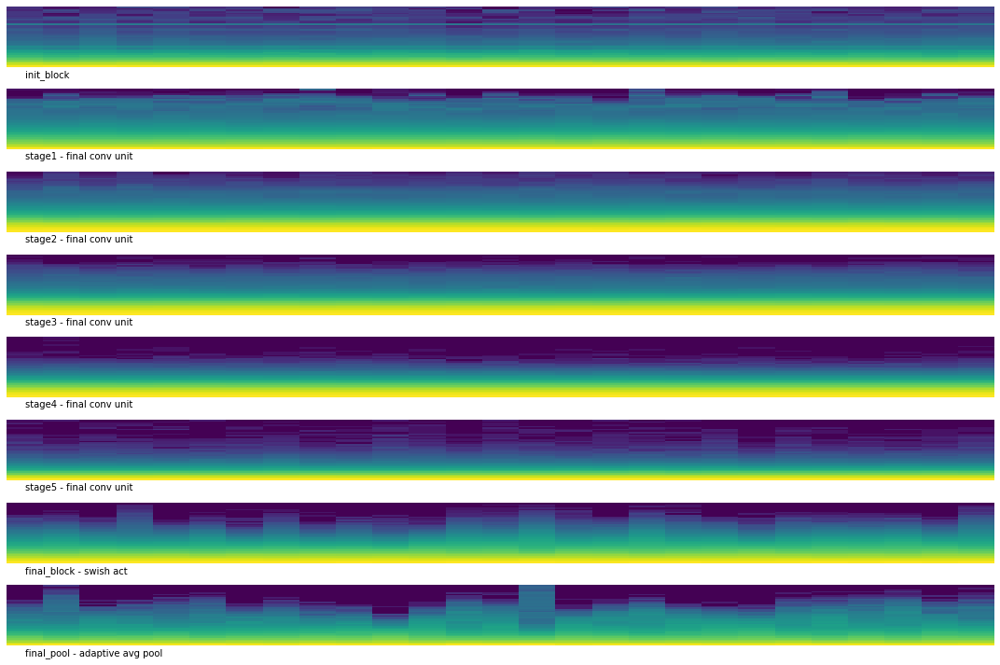

In [111]:
plot_activations(effnet_hooks, effnet_names, 7)

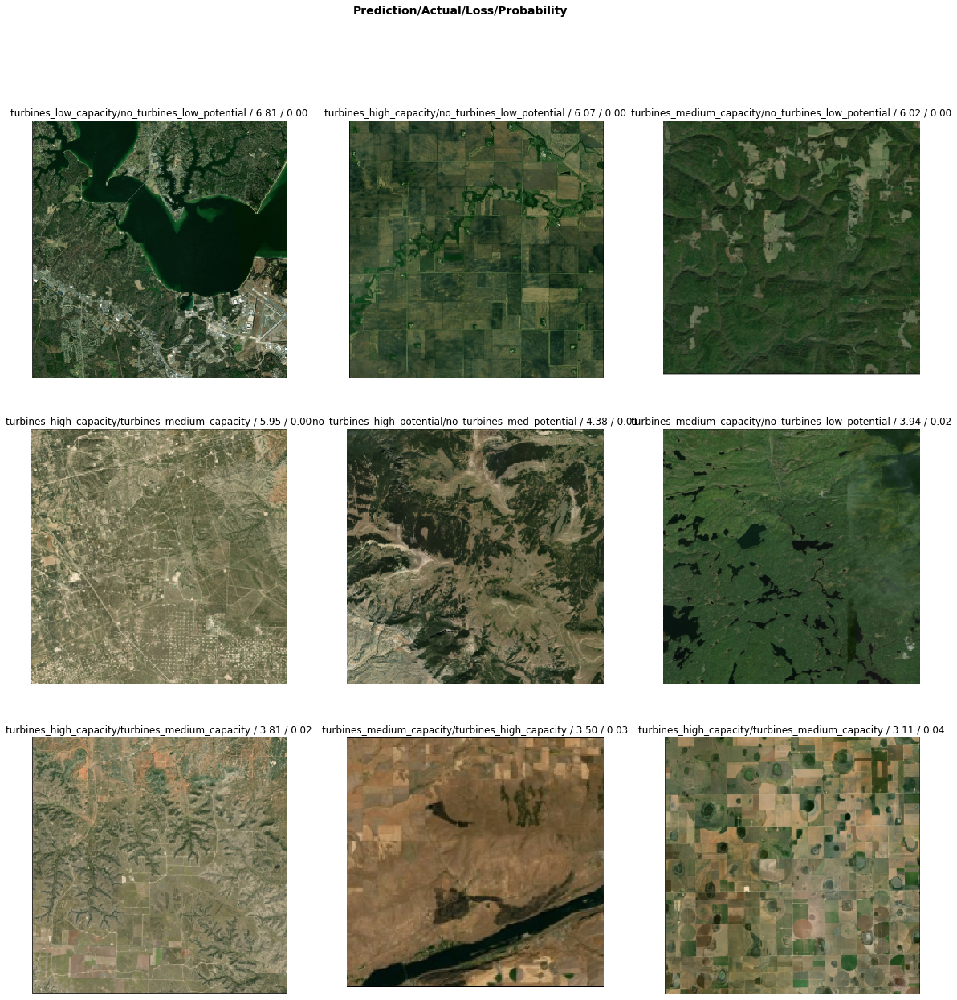

In [114]:
eff_interp2.plot_top_losses(9, figsize=(20, 20))

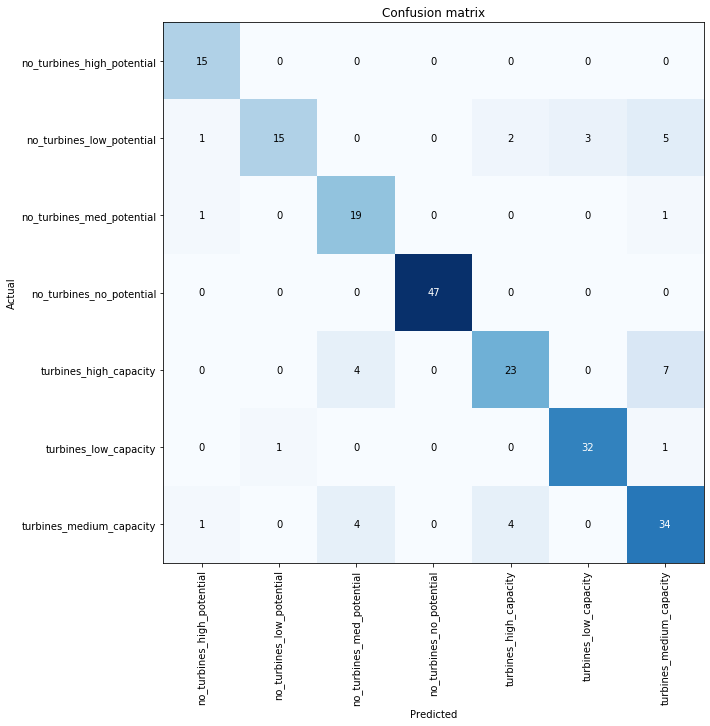

In [115]:
eff_interp2.plot_confusion_matrix(figsize=(10, 10))

#### **Stage 3:**


In [0]:
eff_learn.load('wfs-effnet-v4-phase3')
eff_learn.data = eff_data3 

In [117]:
eff_learn.fit_one_cycle(1,(4e-4,4e-4,4e-4), wd=2e-2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.268777,0.146291,0.050000,0.950000,03:57


In [0]:
eff_preds3, eff_y3, eff_losses3 = eff_learn.get_preds(with_loss=True)
eff_interp3 = ClassificationInterpretation(eff_learn, eff_preds3, eff_y3, eff_losses3)


In [0]:
accuracy(*eff_learn.TTA())

tensor(0.8909)

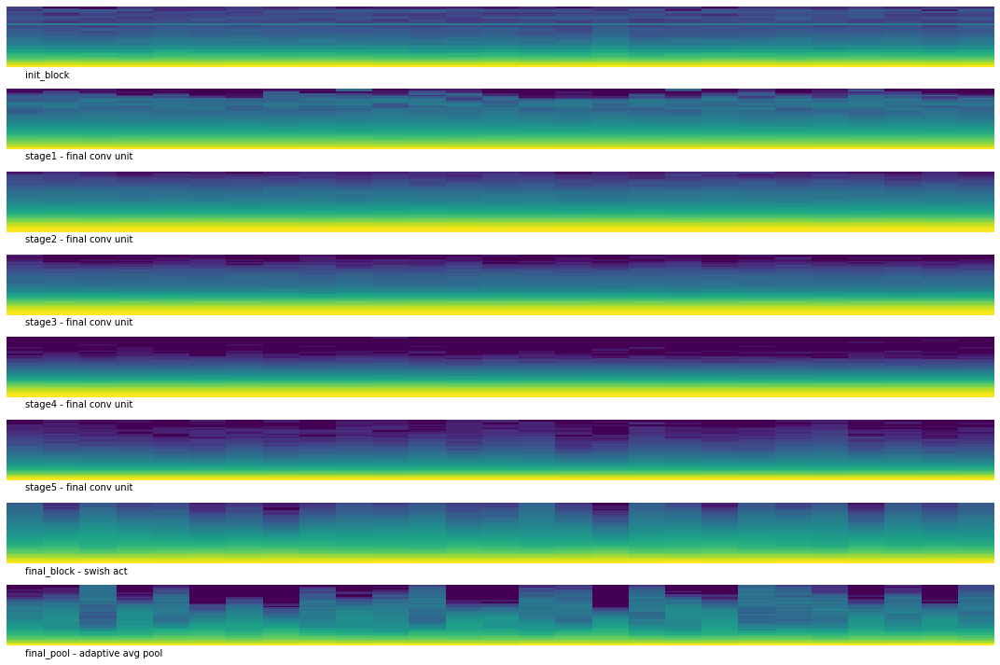

In [119]:
plot_activations(effnet_hooks, effnet_names, 7)

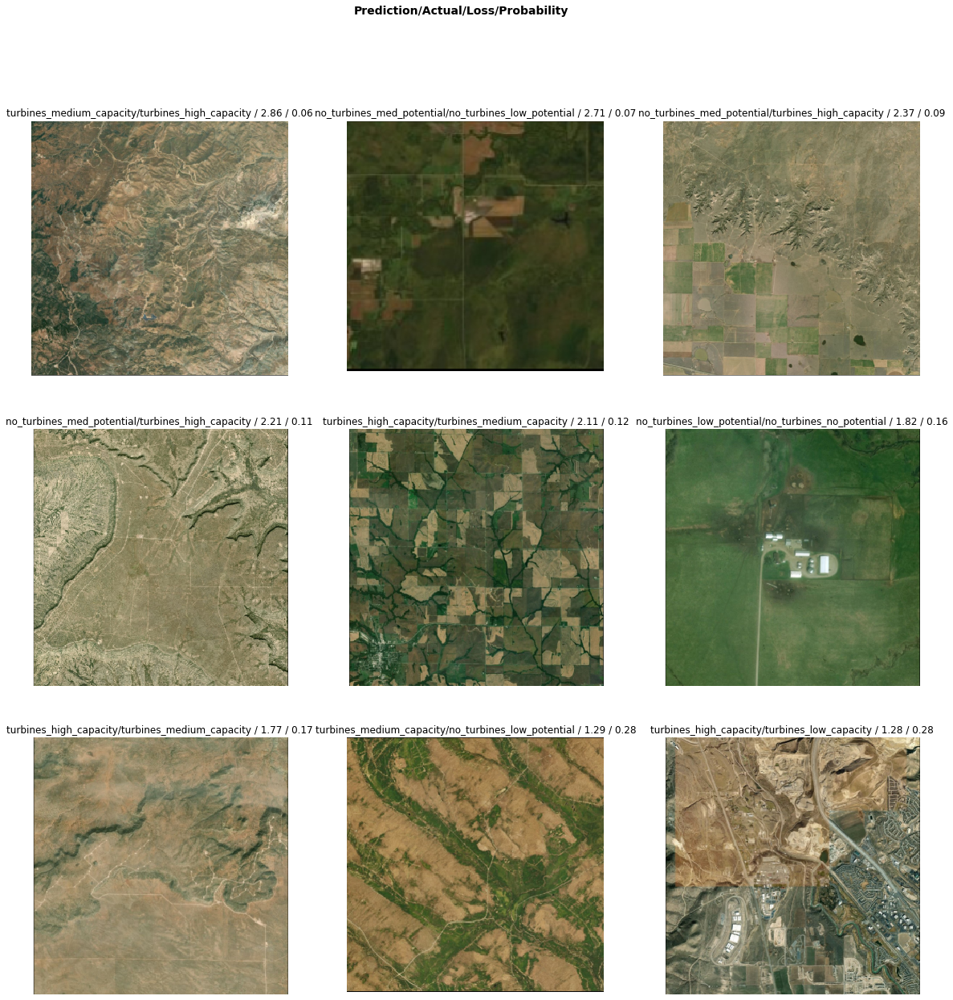

In [120]:
eff_interp3.plot_top_losses(9, figsize=(20, 20))

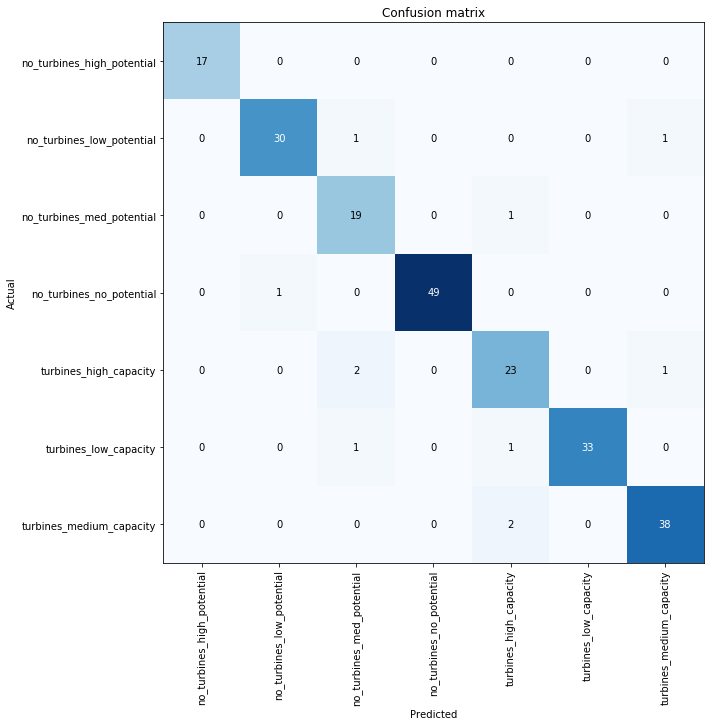

In [122]:
eff_interp3.plot_confusion_matrix(figsize=(10, 10))

In [123]:
gc.collect()

47141

#### **Stage 4:**


In [0]:
eff_learn.load('wfs-effnet-v4-phase4')

In [125]:
eff_learn.fit_one_cycle(1, (4e-5,4e-5,4e-4), wd=2e-2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.138226,0.099247,0.036364,0.963636,03:57


In [0]:
eff_preds4, eff_y4, eff_losses4 = eff_learn.get_preds(with_loss=True)
eff_interp4 = ClassificationInterpretation(eff_learn, eff_preds4, eff_y4, eff_losses4)

In [0]:
accuracy(*eff_learn.TTA())

tensor(0.9409)

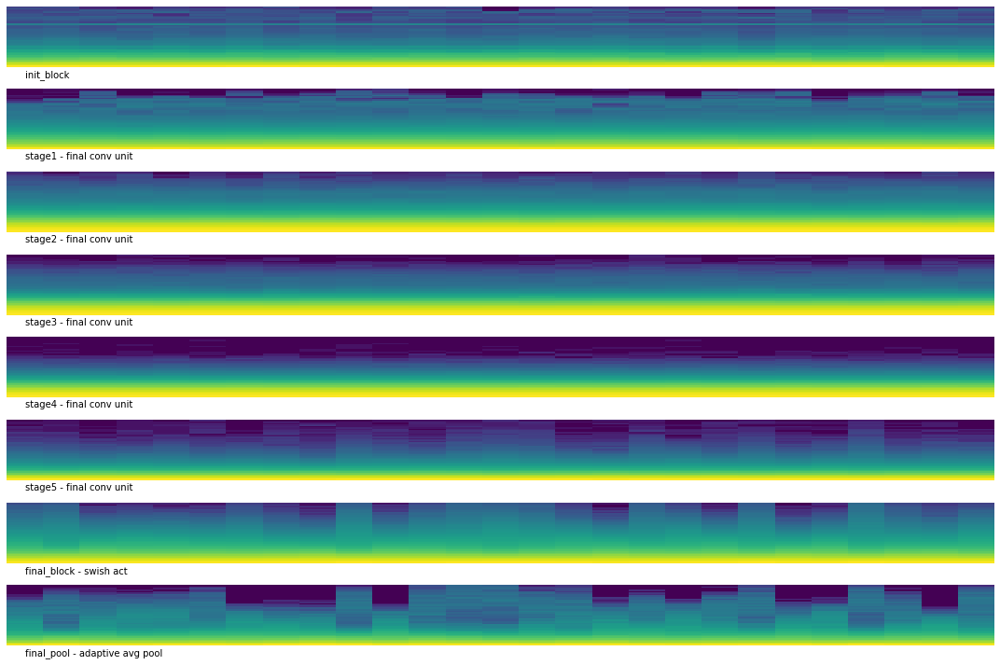

In [127]:
plot_activations(effnet_hooks, effnet_names, 7)

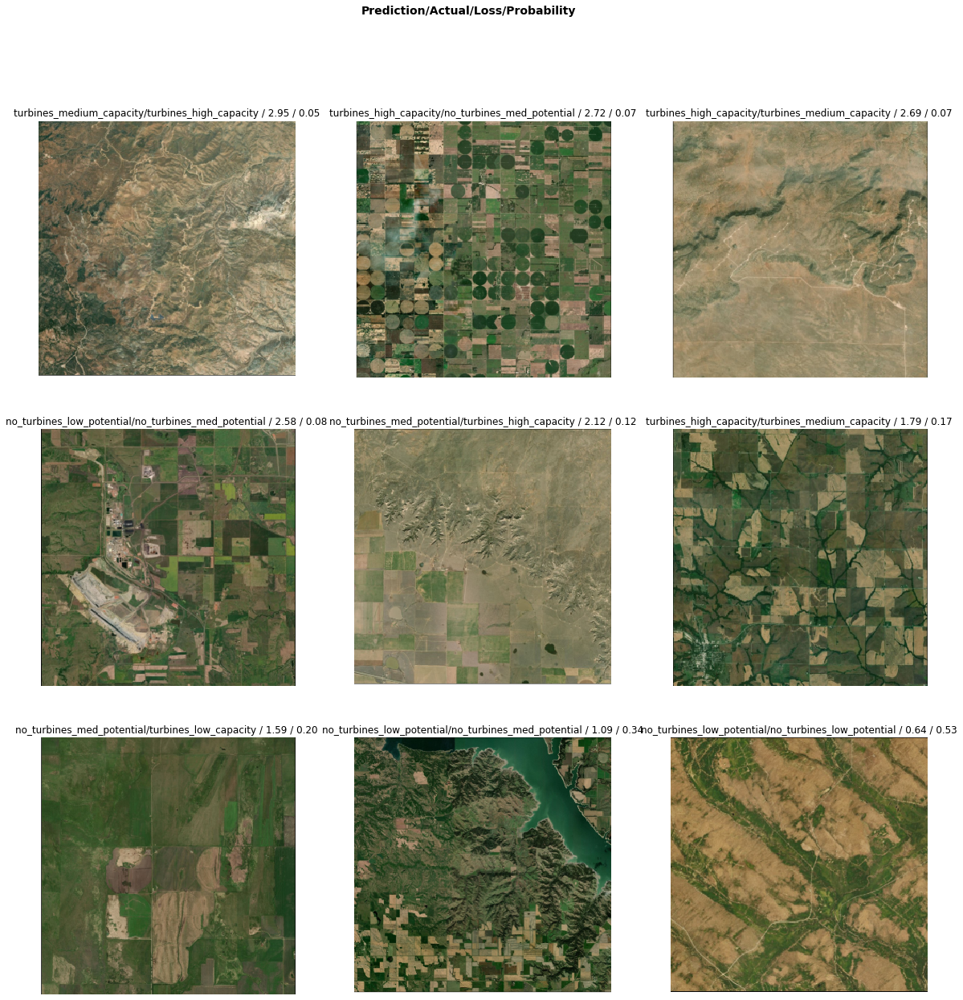

In [129]:
eff_interp4.plot_top_losses(9, figsize=(20, 20))

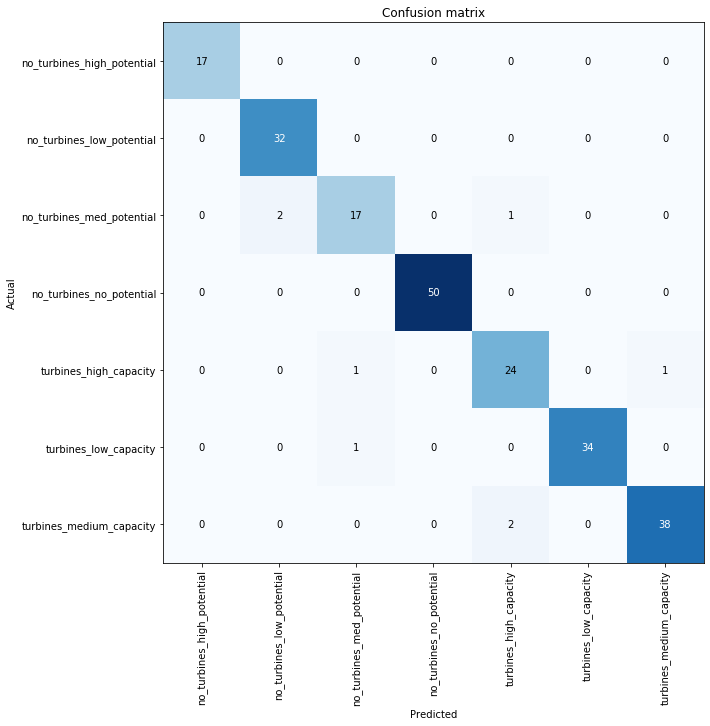

In [130]:
eff_interp4.plot_confusion_matrix(figsize=(10, 10))

In [131]:
gc.collect()

47277

#### **Stage 5:**

In [0]:
eff_learn.load('wfs-effnet-v4-phase5').freeze()
eff_learn.data = eff_data4 

In [133]:
eff_learn.fit_one_cycle(1, 6e-6, wd=2e-2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.169106,0.113883,0.027273,0.972727,04:00


In [0]:
eff_preds5, eff_y5, eff_losses5 = eff_learn.get_preds(with_loss=True)
eff_interp5 = ClassificationInterpretation(eff_learn, eff_preds5, eff_y5, eff_losses5)

In [0]:
accuracy(*eff_learn.TTA())

tensor(0.9045)

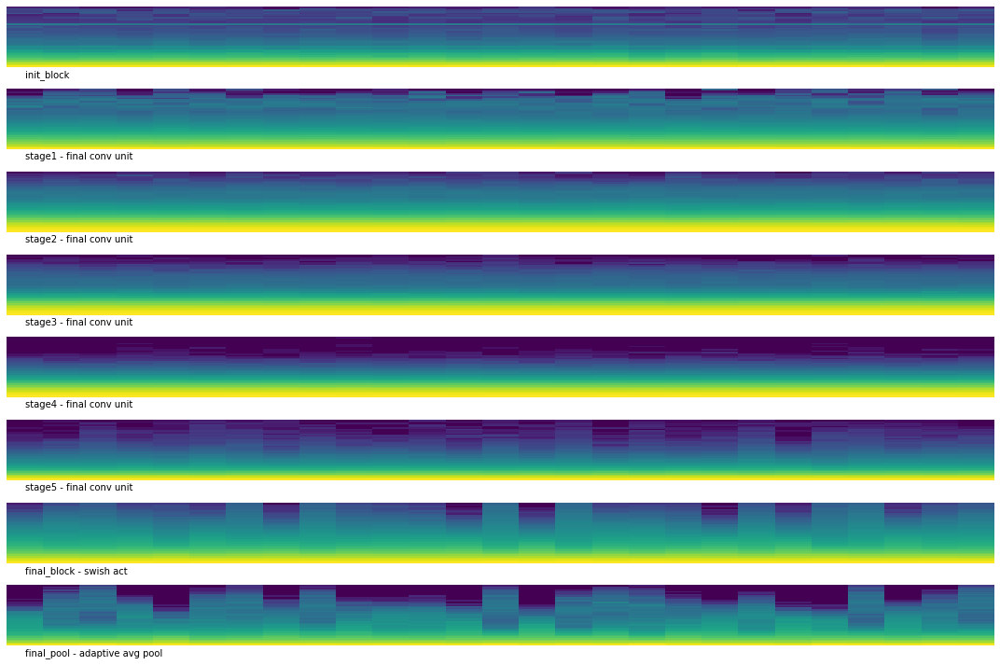

In [135]:
plot_activations(effnet_hooks, effnet_names, 7)

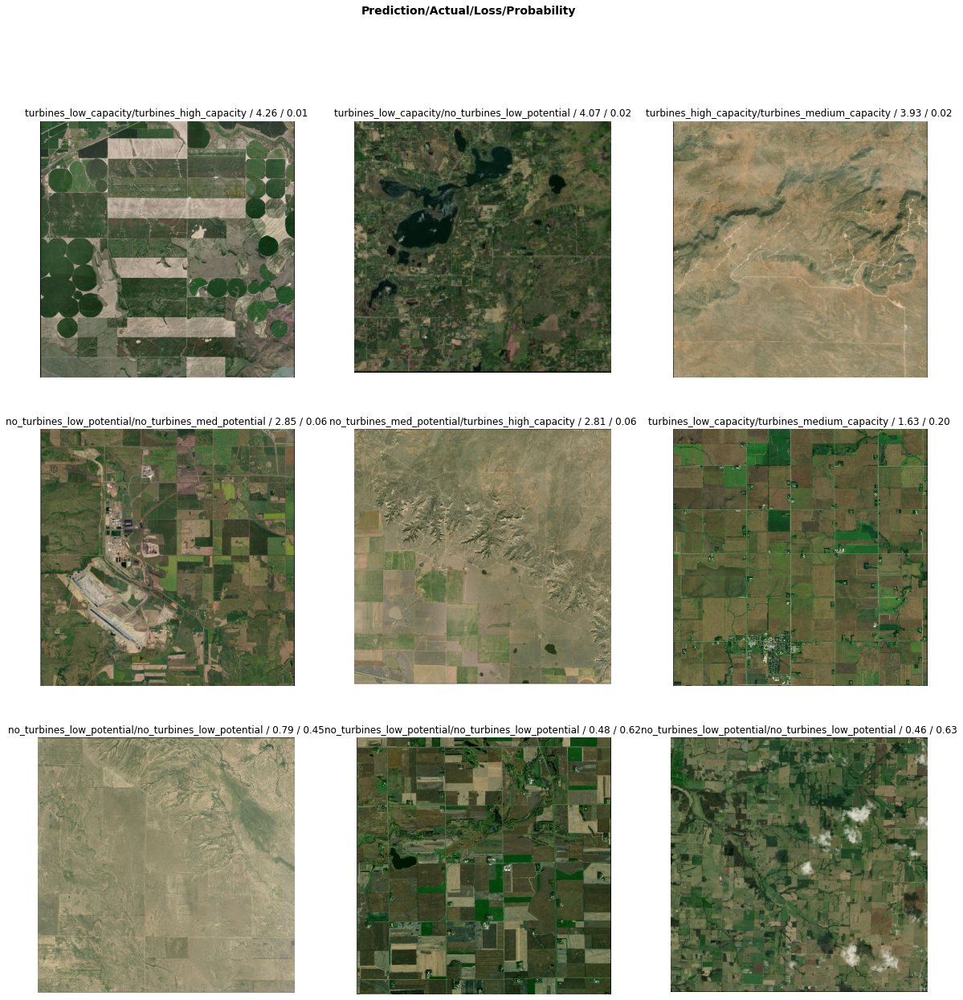

In [137]:
eff_interp5.plot_top_losses(9, figsize=(20, 20))

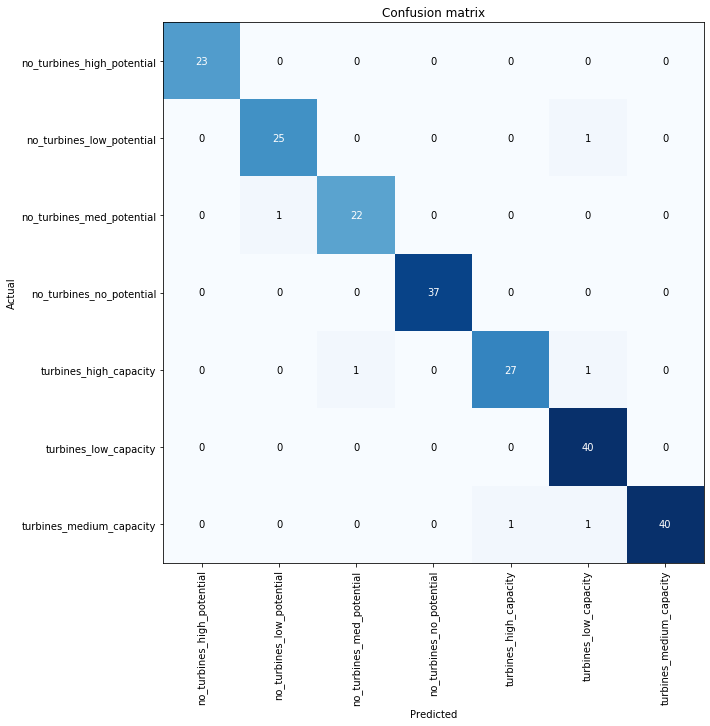

In [138]:
eff_interp5.plot_confusion_matrix(figsize=(10, 10))

In [139]:
gc.collect()

47161

#### **Stage 6:**



In [0]:
eff_learn.load('wfs-effnet-v4-phase6').unfreeze()

In [141]:
eff_learn.fit_one_cycle(1, (4e-5,4e-5,4e-4))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.066541,0.010871,0.000000,1.000000,04:02


In [0]:
eff_preds6, eff_y6, eff_losses6 = eff_learn.get_preds(with_loss=True)
eff_interp6 = ClassificationInterpretation(eff_learn, eff_preds6, eff_y6, eff_losses6)

In [0]:
accuracy(*eff_learn.TTA())

tensor(0.9455)

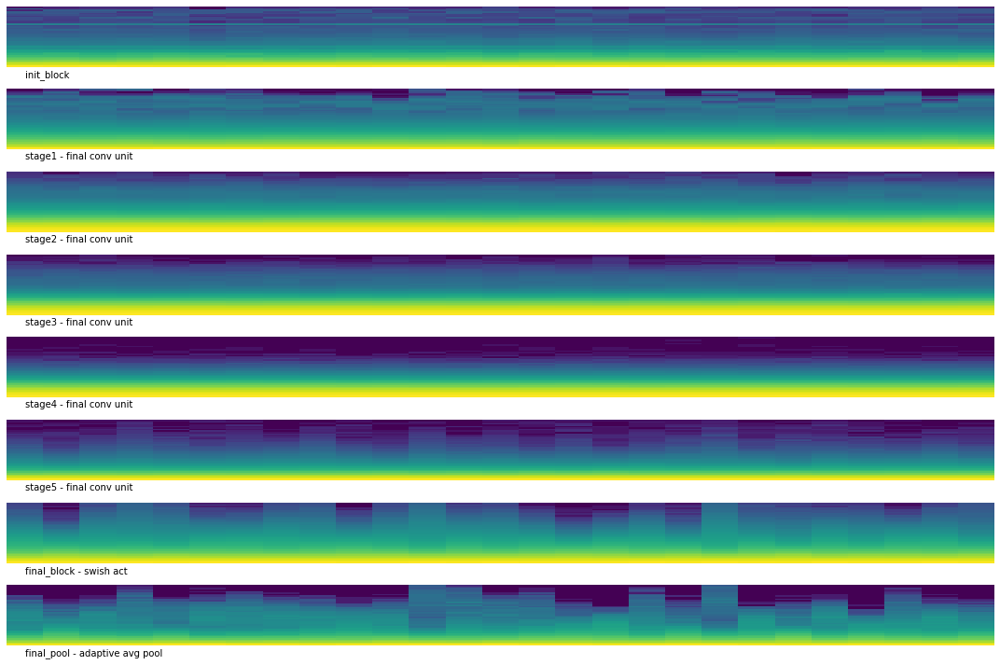

In [145]:
plot_activations(effnet_hooks, effnet_names, 7)

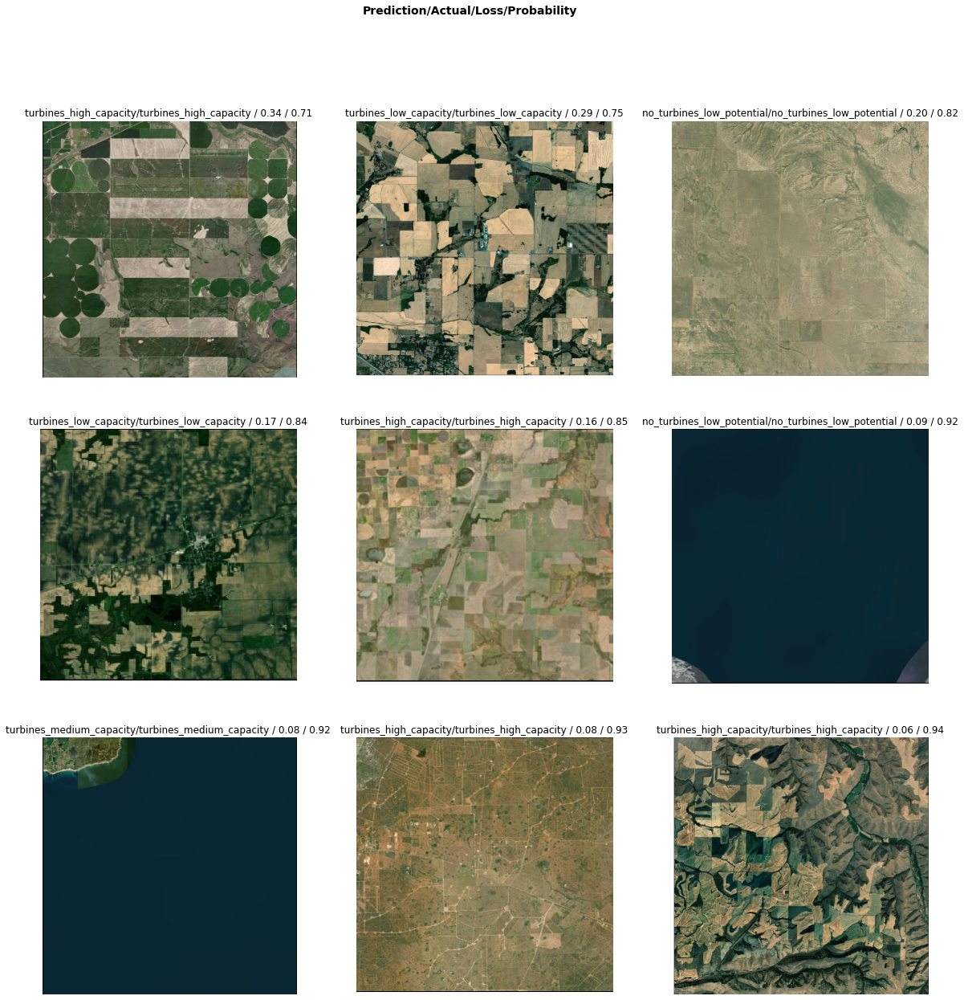

In [147]:
eff_interp6.plot_top_losses(9, figsize=(20, 20))

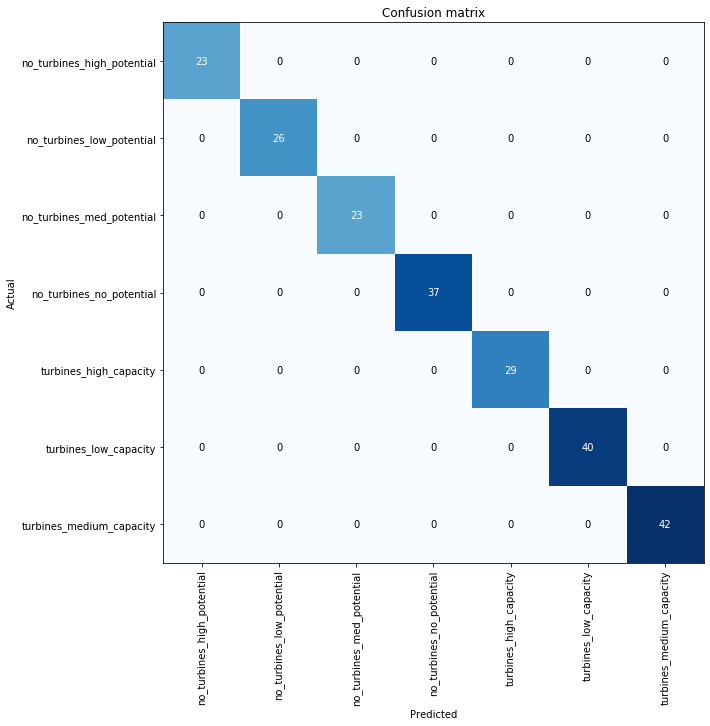

In [148]:
eff_interp6.plot_confusion_matrix(figsize=(10, 10))

In [149]:
gc.collect()

62413

### **Evaluating Training and Activations for Inception-v3**

In [0]:
def inceptionv3(pretrained=True):
    return ptcv_get_model("inceptionv3", pretrained=pretrained).features

In [151]:
inc_learn = cnn_learner(inc_data1, inceptionv3, pretrained=True, metrics=[error_rate, accuracy], cut=noop, split_on=lambda m: (m[0][3], m[1]))


In [0]:
#print(inc_learn.model[0].children)

In [0]:
inc_hooks = [
                probeModule(inc_learn, inc_learn.model[0][0]),
                probeModule(inc_learn, inc_learn.model[0][1]),
                probeModule(inc_learn, inc_learn.model[0][2]),
                probeModule(inc_learn, inc_learn.model[0][3]),
                probeModule(inc_learn, inc_learn.model[0][4])
                ]

inc_names = [
                'init_block',
                'stage1',
                'stage2',
                'stage3',
                'final_pool'
                ]

#### **Stage 1:**

In [0]:
inc_learn.load('wfs-incept-phase1-a')

In [155]:
inc_learn.fit_one_cycle(1, 4e-2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.646530,1.432667,0.431818,0.568182,03:49


In [0]:
inc_preds1, inc_y1, inc_losses1 = inc_learn.get_preds(with_loss=True)
inc_interp1 = ClassificationInterpretation(inc_learn, inc_preds1, inc_y1, inc_losses1)

In [0]:
accuracy(*inc_learn.TTA())

tensor(0.6000)

In [0]:
def plot_activations(hooks, names, num_layers):
  fig,axes = plt.subplots(5, figsize=(15,10))
  for i, (ax,h) in enumerate(zip(axes.flatten(), hooks)):
    ax.imshow(get_hist(h), origin='lower', aspect='auto')
    ax.axis('off')
    ax.text(0, -num_layers, names[i], bbox={'facecolor':'red', 'alpha':0.0, 'pad':10})
    plt.tight_layout()

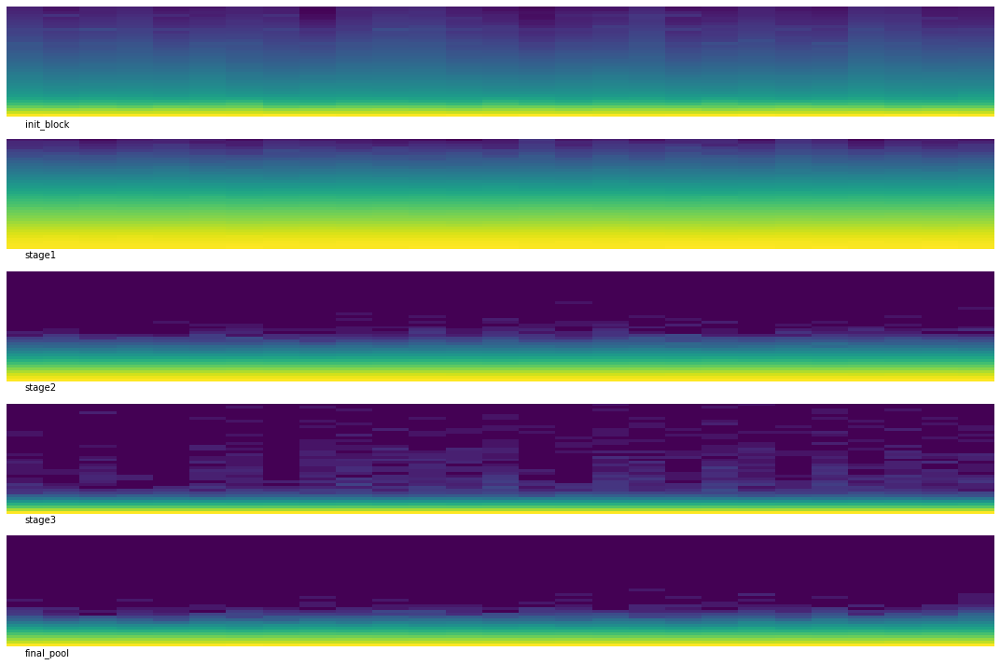

In [159]:
plot_activations(inc_hooks, inc_names, 4)

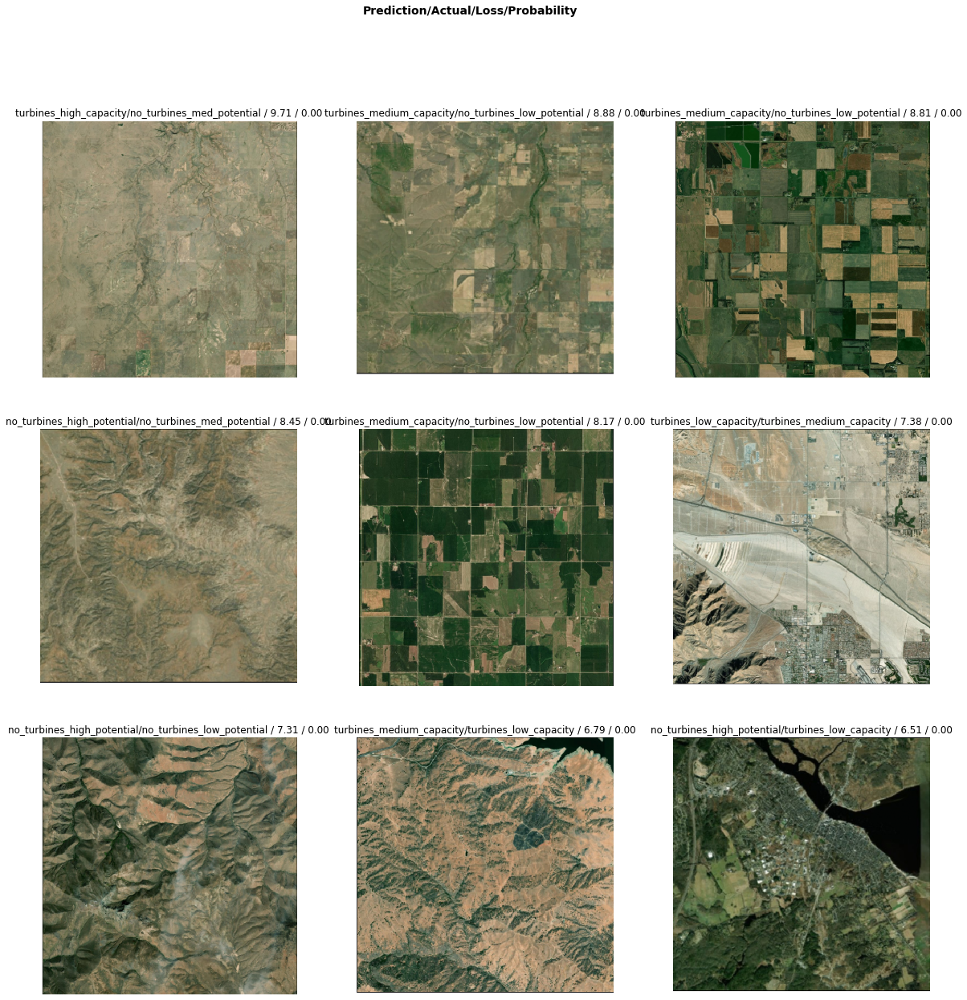

In [204]:
inc_interp1.plot_top_losses(9, figsize=(20, 20))

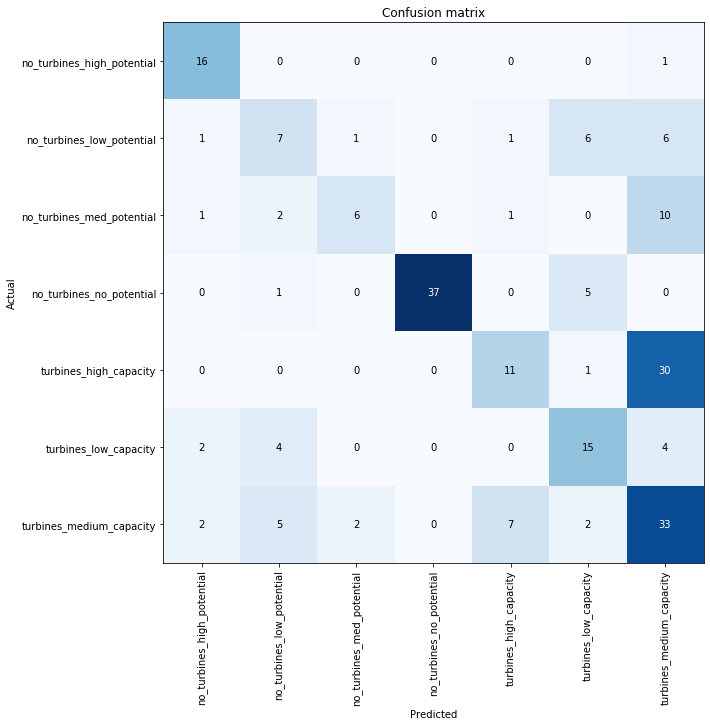

In [205]:
inc_interp1.plot_confusion_matrix(figsize=(10, 10))

#### **Stage 2:**

In [0]:
inc_learn.load('wfs-incept-phase2-b').unfreeze()

In [207]:
inc_learn.fit_one_cycle(1, (4e-4,4e-4,4e-4), wd=2e-2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.113613,1.319672,0.327273,0.672727,03:49


In [0]:
inc_preds2, inc_y2, inc_losses2 = inc_learn.get_preds(with_loss=True)
inc_interp2 = ClassificationInterpretation(inc_learn, inc_preds2, inc_y2, inc_losses2)

In [0]:
accuracy(*inc_learn.TTA())

tensor(0.5955)

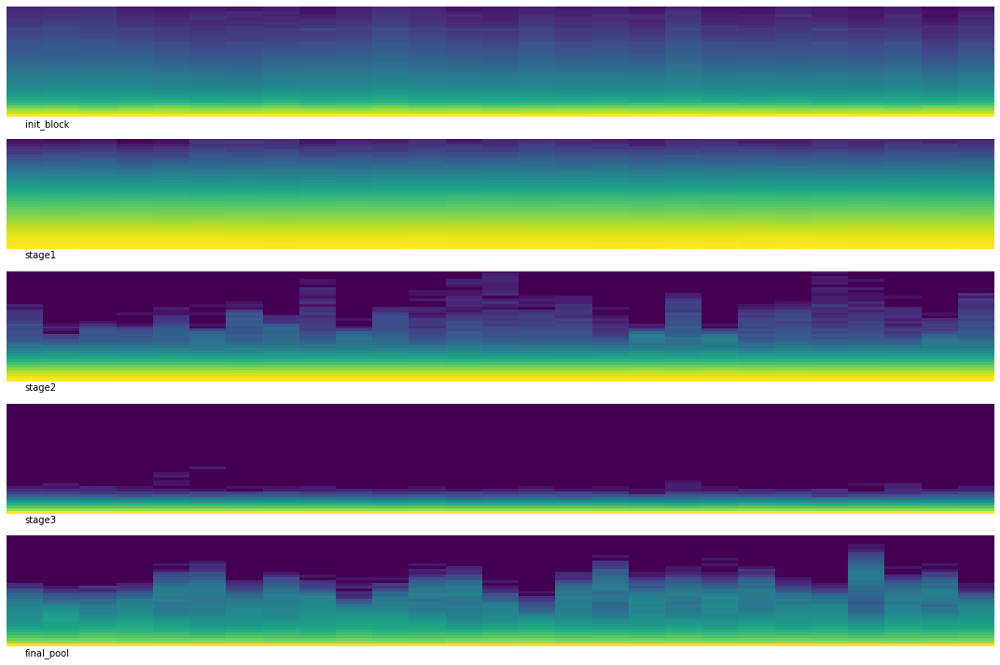

In [209]:
plot_activations(inc_hooks, inc_names, 4)

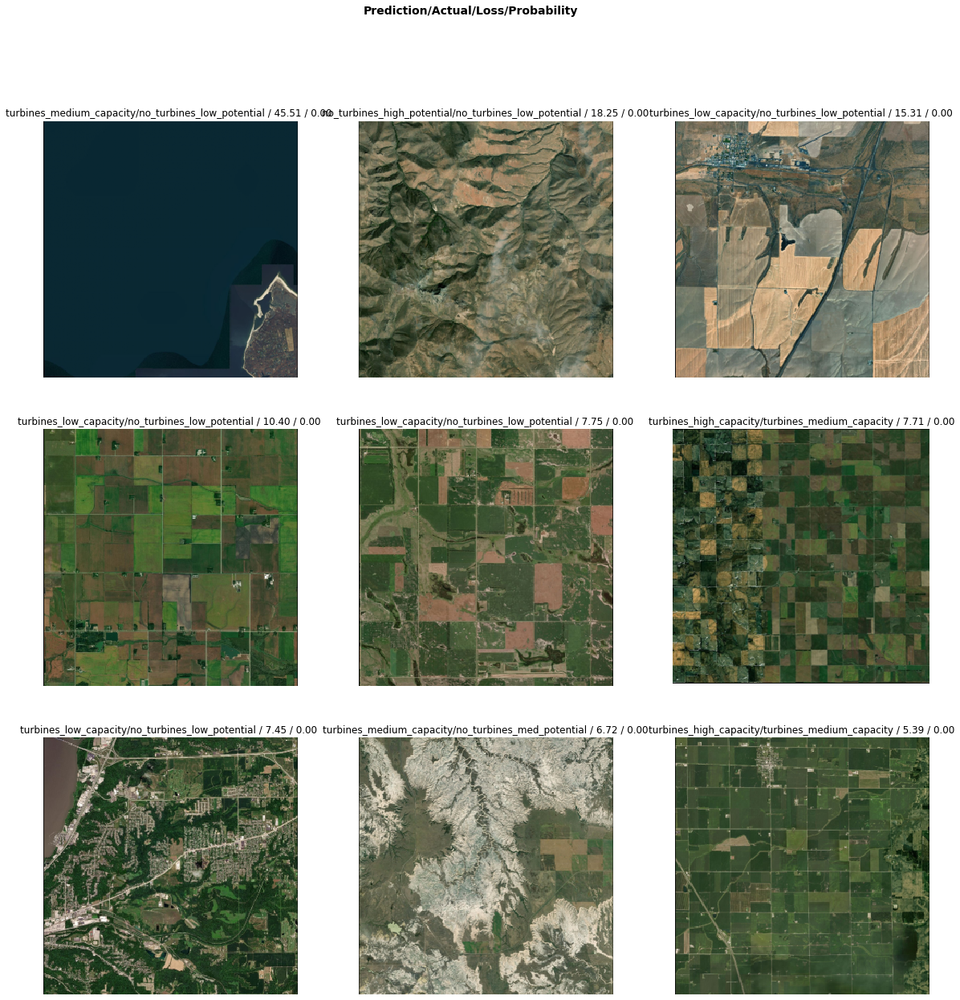

In [210]:
inc_interp2.plot_top_losses(9, figsize=(20, 20))

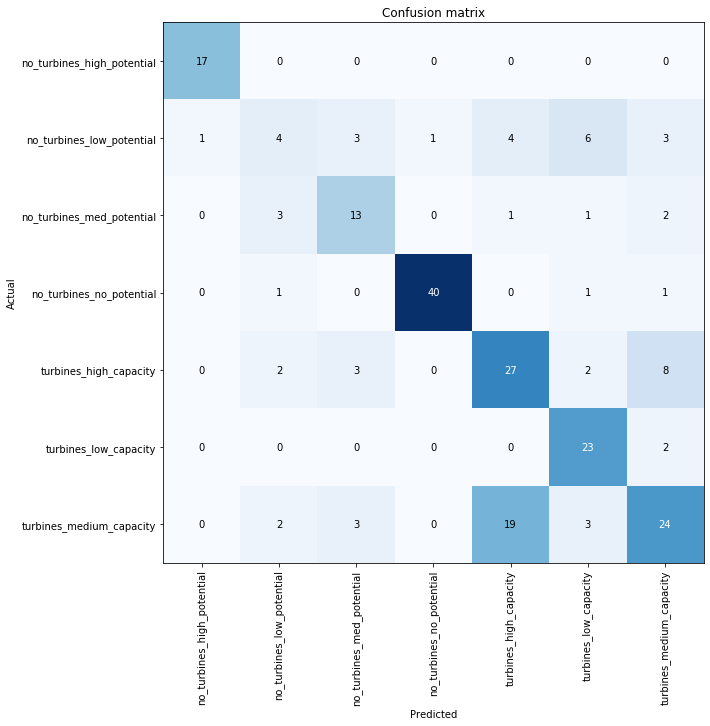

In [211]:
inc_interp2.plot_confusion_matrix(figsize=(10, 10))

In [212]:
gc.collect()

27844

#### **Stage 3:**

In [0]:
inc_learn.load('wfs-incept-phase3-c')
inc_learn.data = inc_data2

In [214]:
inc_learn.fit_one_cycle(1, (4e-5,4e-4,4e-4))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.594189,0.362895,0.104545,0.895455,03:55


In [0]:
inc_preds3, inc_y3, inc_losses3 = inc_learn.get_preds(with_loss=True)
inc_interp3 = ClassificationInterpretation(inc_learn, inc_preds3, inc_y3, inc_losses3)

In [0]:
accuracy(*inc_learn.TTA())

tensor(0.8318)

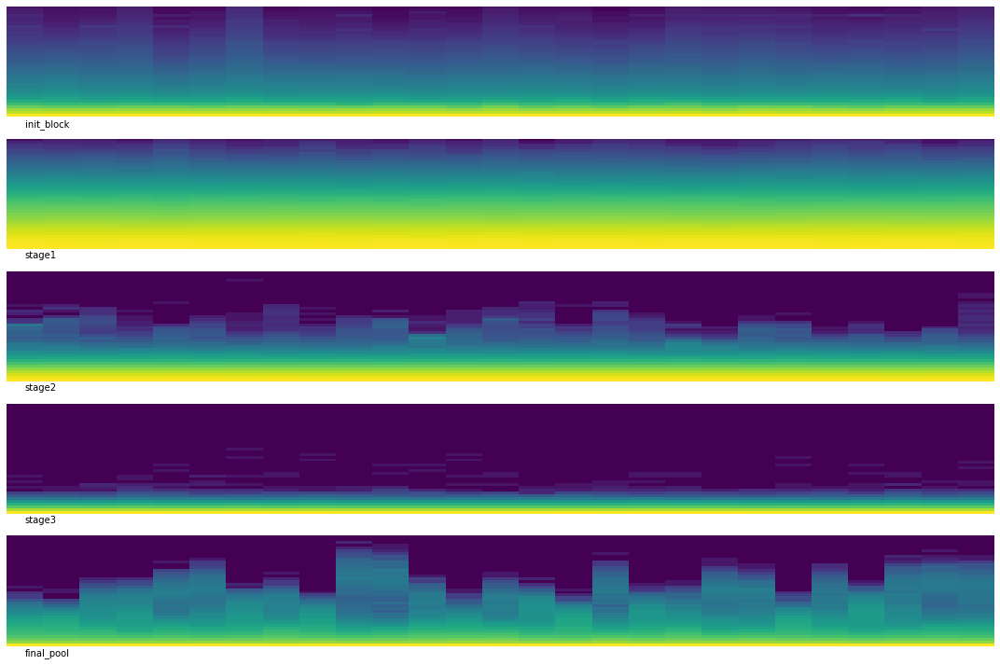

In [216]:
plot_activations(inc_hooks, inc_names, 4)

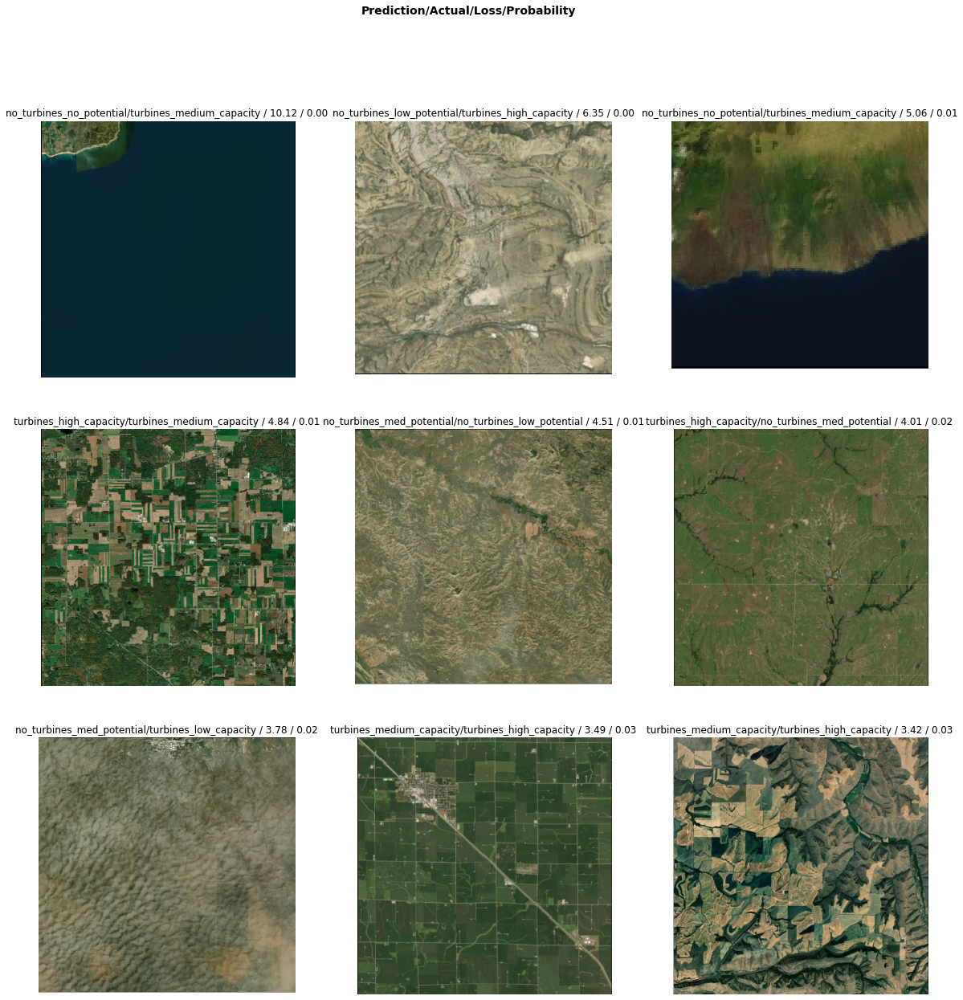

In [217]:
inc_interp3.plot_top_losses(9, heatmap=True, figsize=(20, 20))

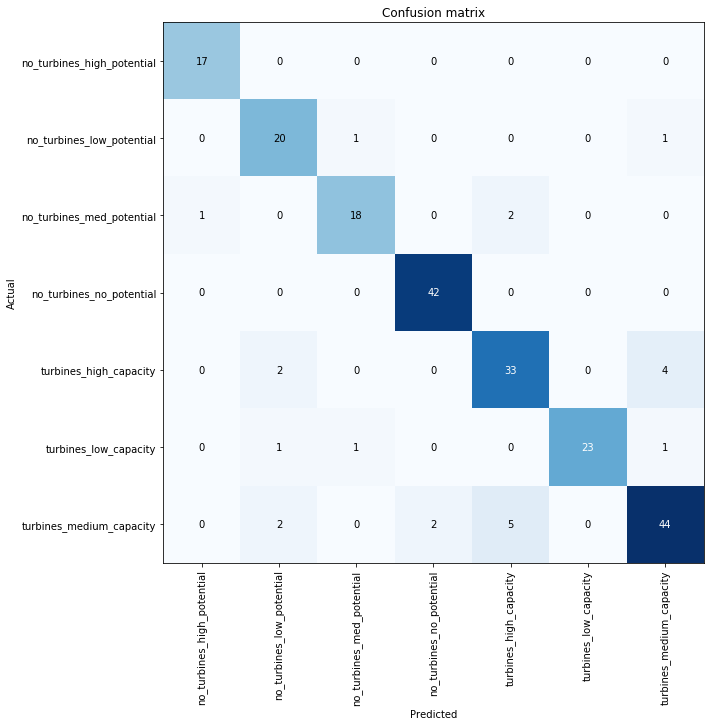

In [218]:
inc_interp3.plot_confusion_matrix(figsize=(10, 10))

#### **Stage 4:**

In [0]:
inc_learn.load('wfs-incept-phase4-d')
inc_learn.data = inc_data3

In [220]:
inc_learn.fit_one_cycle(1, (4e-5,4e-4,4e-4), wd=2e-2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.376789,0.338500,0.104545,0.895455,04:00


In [0]:
inc_preds4, inc_y4, inc_losses4 = inc_learn.get_preds(with_loss=True)
inc_interp4 = ClassificationInterpretation(inc_learn, inc_preds4, inc_y4, inc_losses4)

In [0]:
accuracy(*inc_learn.TTA())

tensor(0.7545)

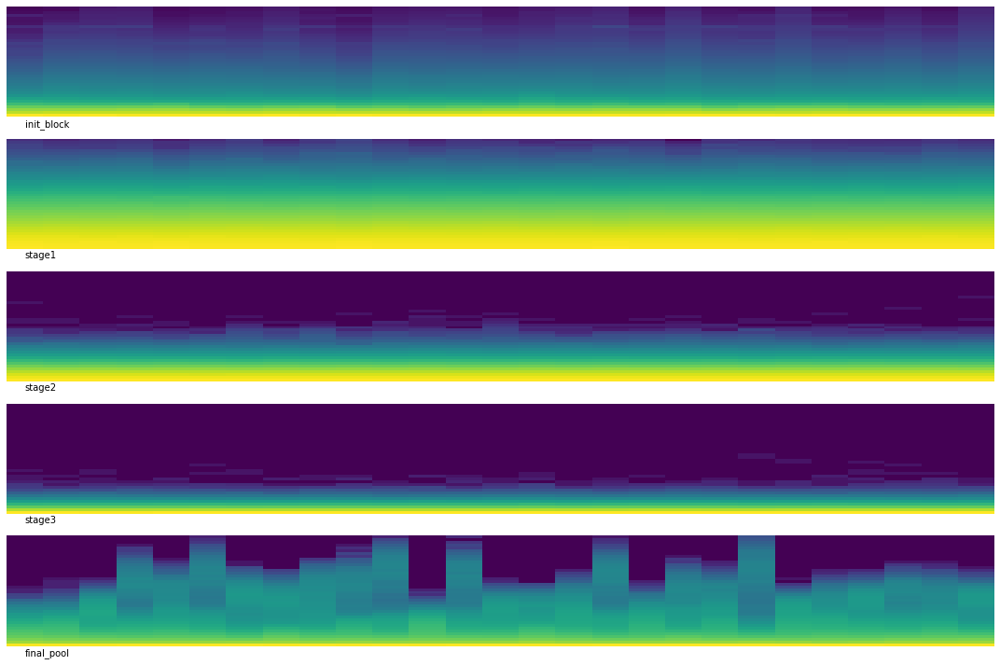

In [222]:
plot_activations(inc_hooks, inc_names, 4)

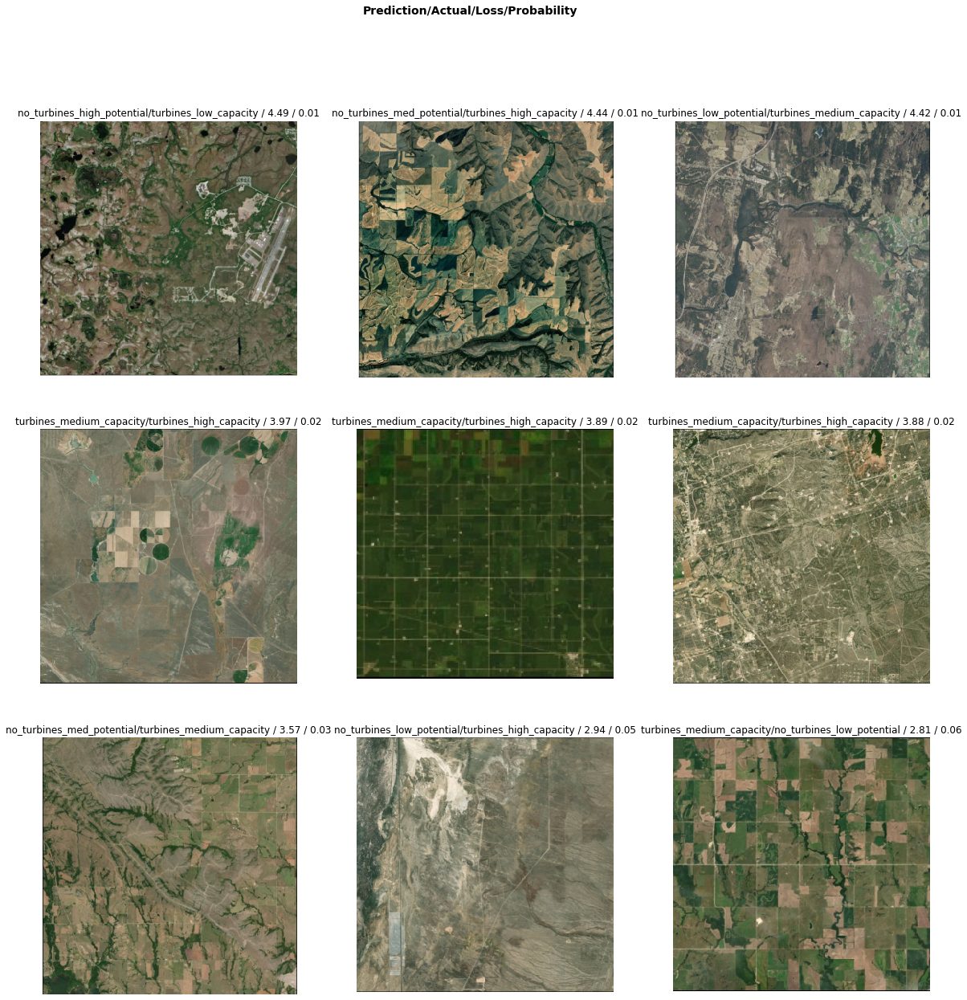

In [223]:
inc_interp4.plot_top_losses(9, figsize=(20, 20))

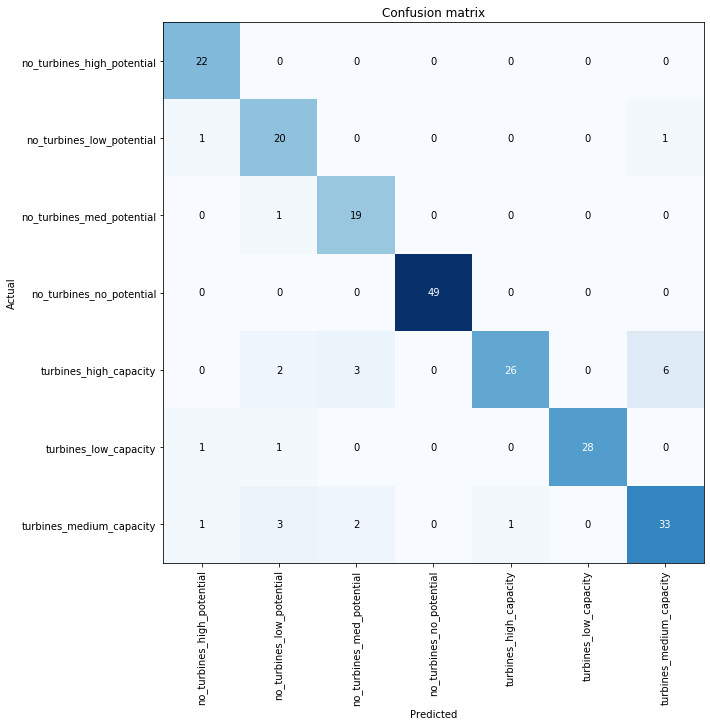

In [224]:
inc_interp4.plot_confusion_matrix(figsize=(10, 10))

In [225]:
gc.collect()

27844

#### **Stage 5:**

In [226]:
inc_learn.load('wfs-incept-phase5-e').freeze()
inc_learn.fit_one_cycle(1, 4e-3, 2e-2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.414504,0.222822,0.059091,0.940909,03:58


In [0]:
inc_preds5, inc_y5, inc_losses5 = inc_learn.get_preds(with_loss=True)
inc_interp5 = ClassificationInterpretation(inc_learn, inc_preds5, inc_y5, inc_losses5)

In [0]:
accuracy(*inc_learn.TTA())

tensor(0.9000)

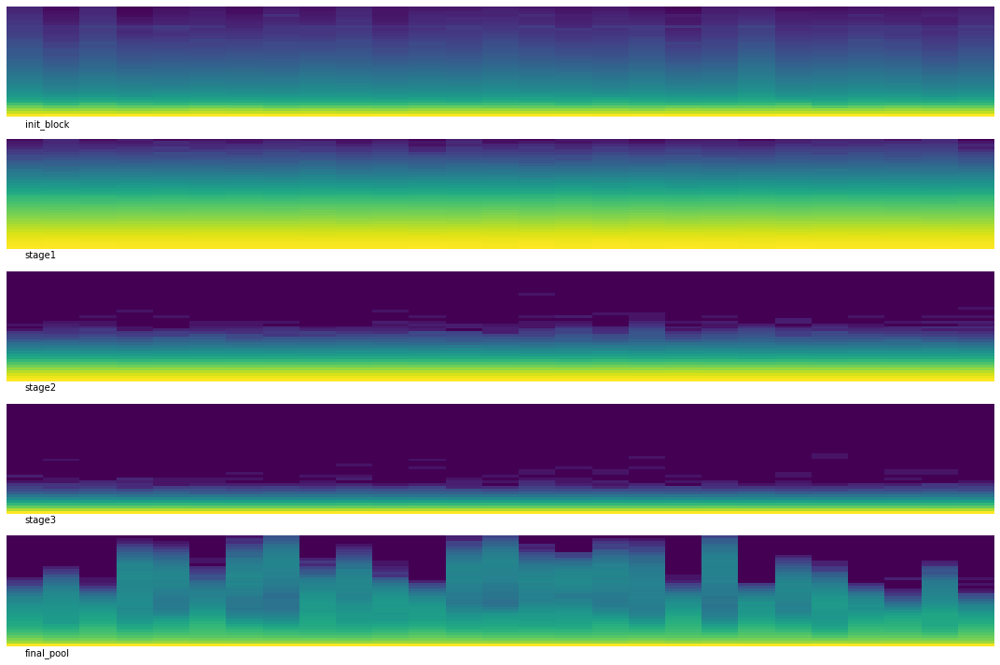

In [228]:
plot_activations(inc_hooks, inc_names, 4)

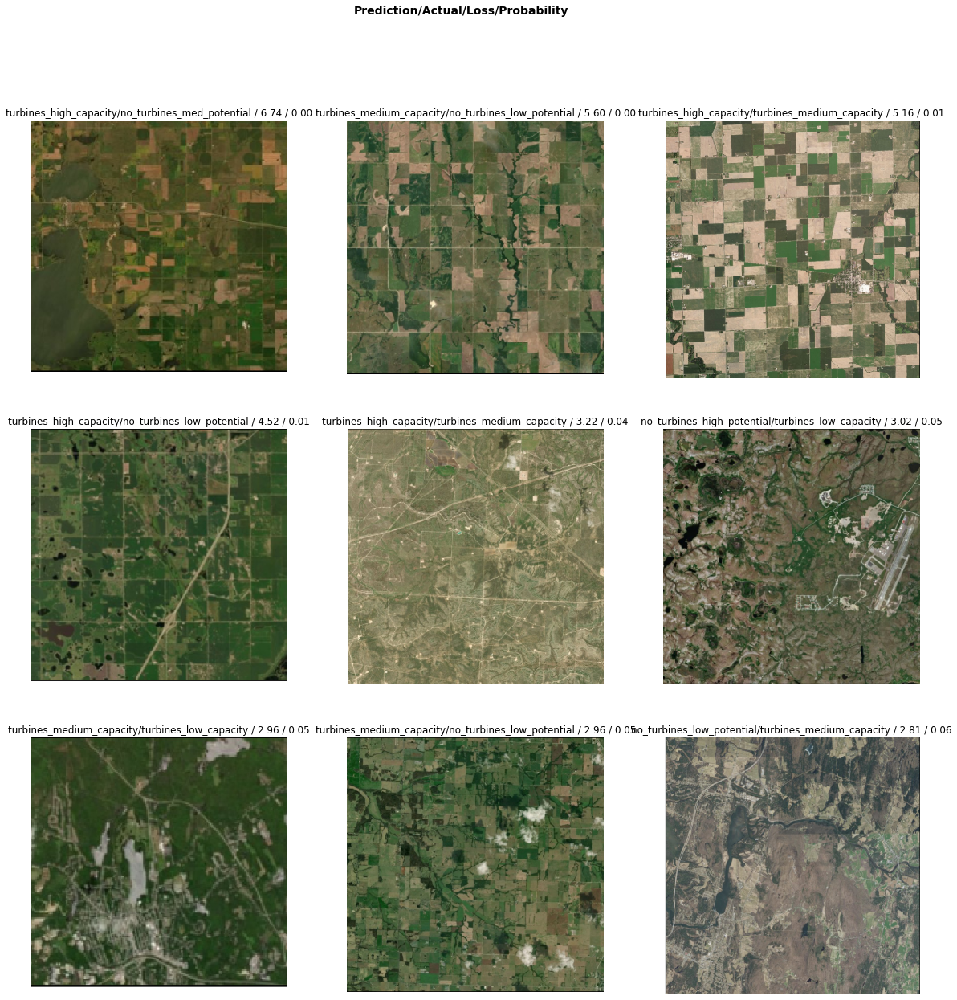

In [229]:
inc_interp5.plot_top_losses(9, heatmap=True, figsize=(20, 20))

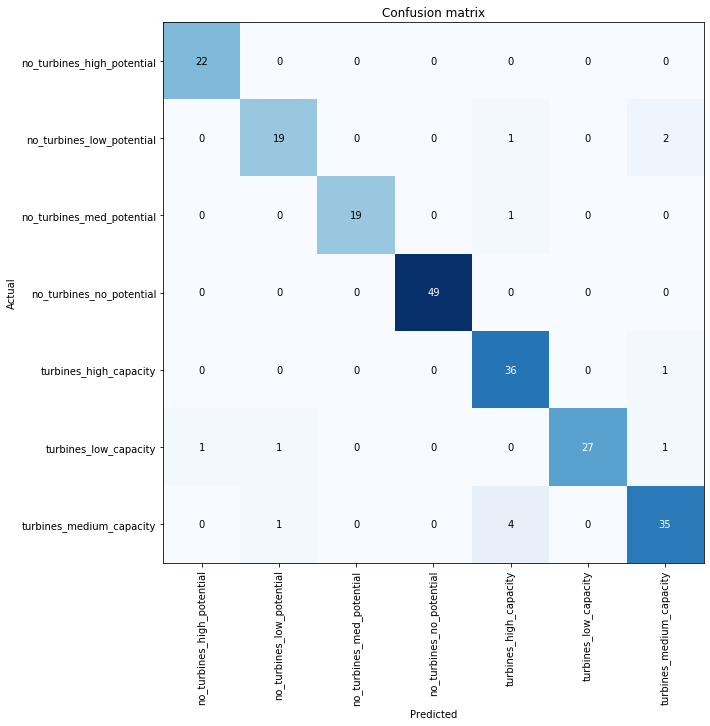

In [230]:
inc_interp5.plot_confusion_matrix(figsize=(10, 10))

In [231]:
gc.collect()

27848

#### **Stage 6:**

In [232]:
inc_learn.load('wfs-incept-phase6-f').unfreeze()
inc_learn.data = inc_data4
inc_learn.fit_one_cycle(1, (4e-4, 4e-4, 4e-4), wd=2e-2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.924001,0.531869,0.163636,0.836364,04:02


In [0]:
inc_preds6, inc_y6, inc_losses6 = inc_learn.get_preds(with_loss=True)
inc_interp6 = ClassificationInterpretation(inc_learn, inc_preds6, inc_y6, inc_losses6)

In [0]:
accuracy(*inc_learn.TTA())

tensor(0.8045)

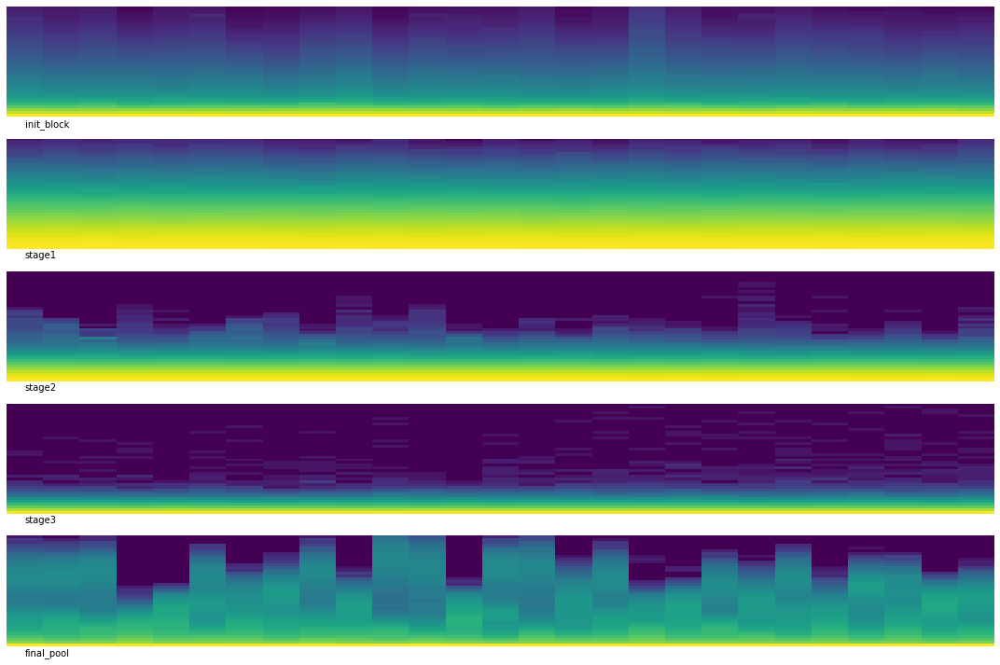

In [234]:
plot_activations(inc_hooks, inc_names, 4)

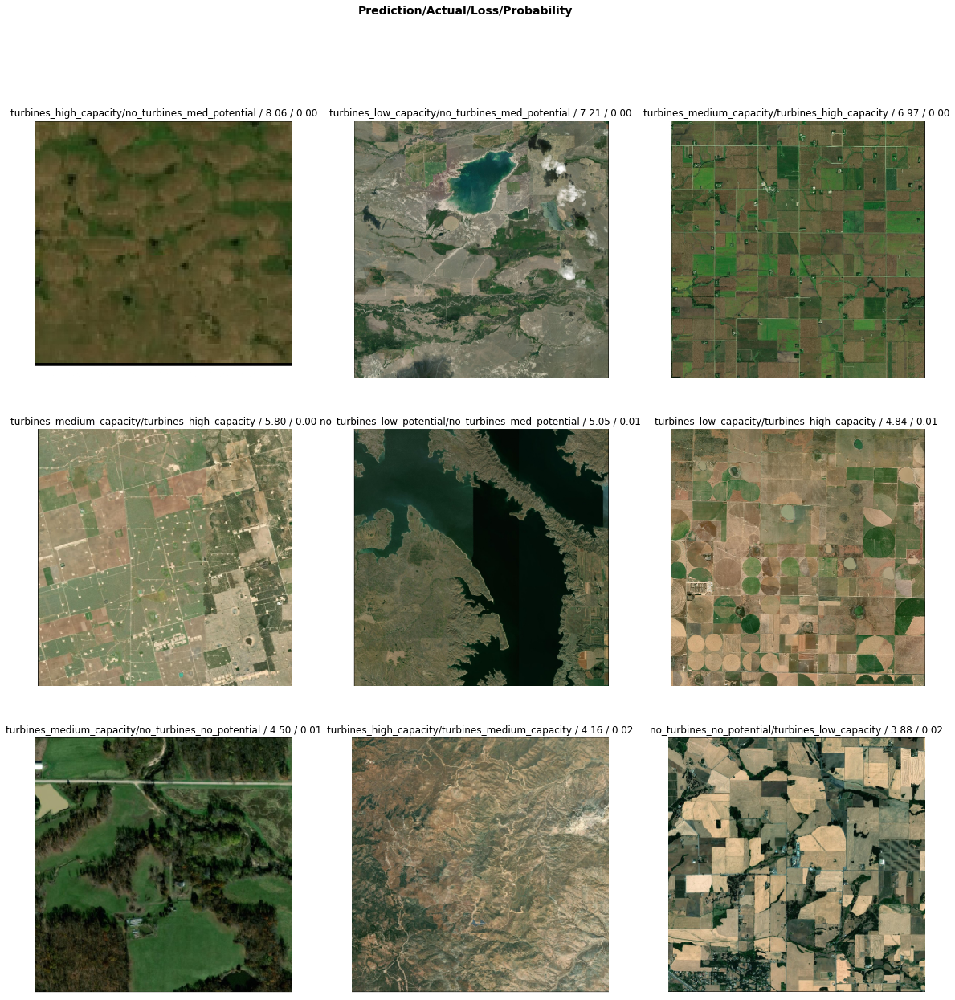

In [235]:
inc_interp6.plot_top_losses(9, heatmap=True, figsize=(20, 20))

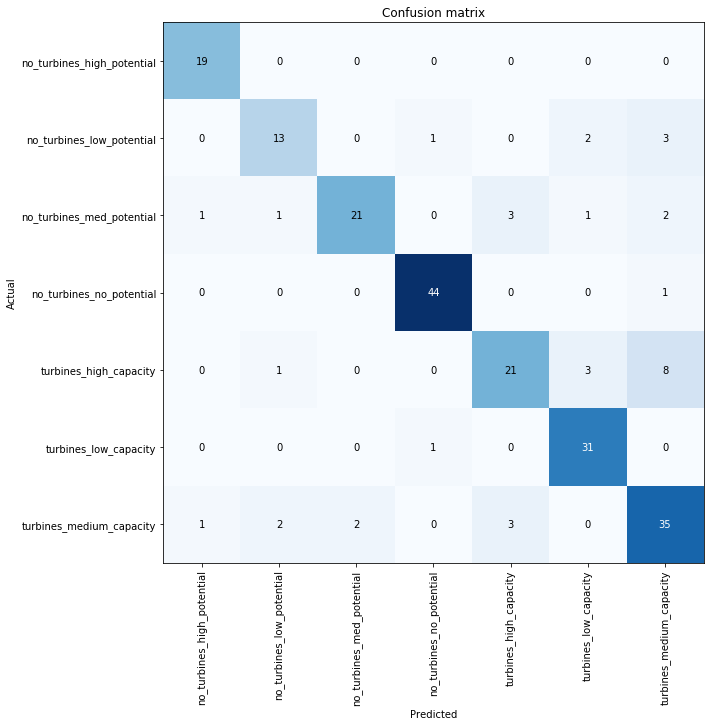

In [236]:
inc_interp6.plot_confusion_matrix(figsize=(10, 10))

In [237]:
gc.collect()

27849

#### **Stage 7:**

In [238]:
inc_learn.load('wfs-incept-phase7-g').freeze()
inc_learn.fit_one_cycle(1, 4e-3, wd=2e-2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.381194,0.254598,0.050000,0.950000,04:01


In [0]:
inc_preds7, inc_y7, inc_losses7 = inc_learn.get_preds(with_loss=True)
inc_interp7 = ClassificationInterpretation(inc_learn, inc_preds7, inc_y7, inc_losses7)

In [0]:
accuracy(*inc_learn.TTA())

tensor(0.9182)

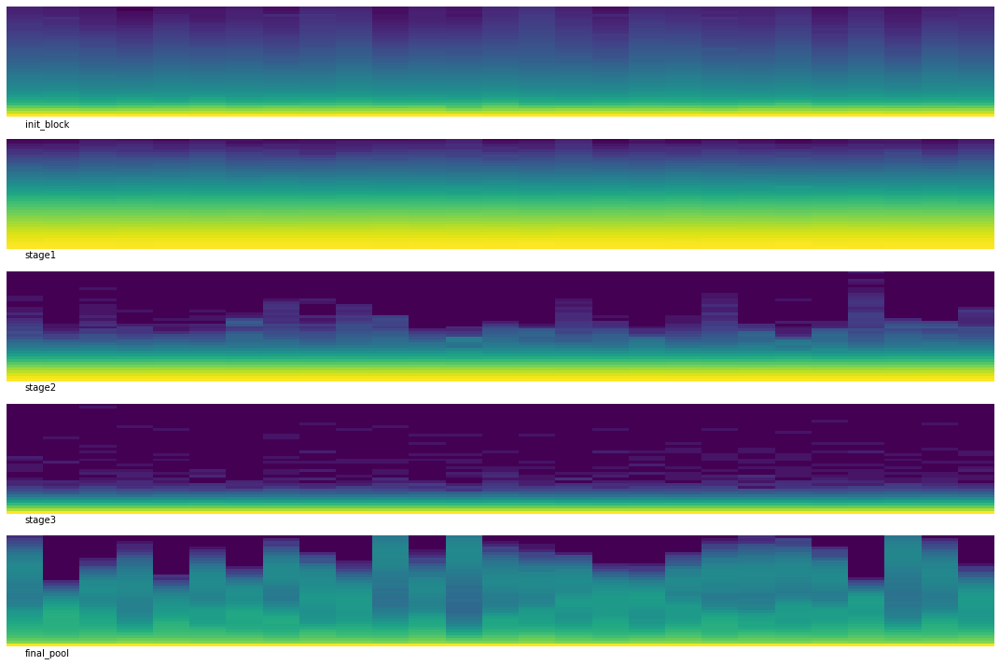

In [240]:
plot_activations(inc_hooks, inc_names, 4)

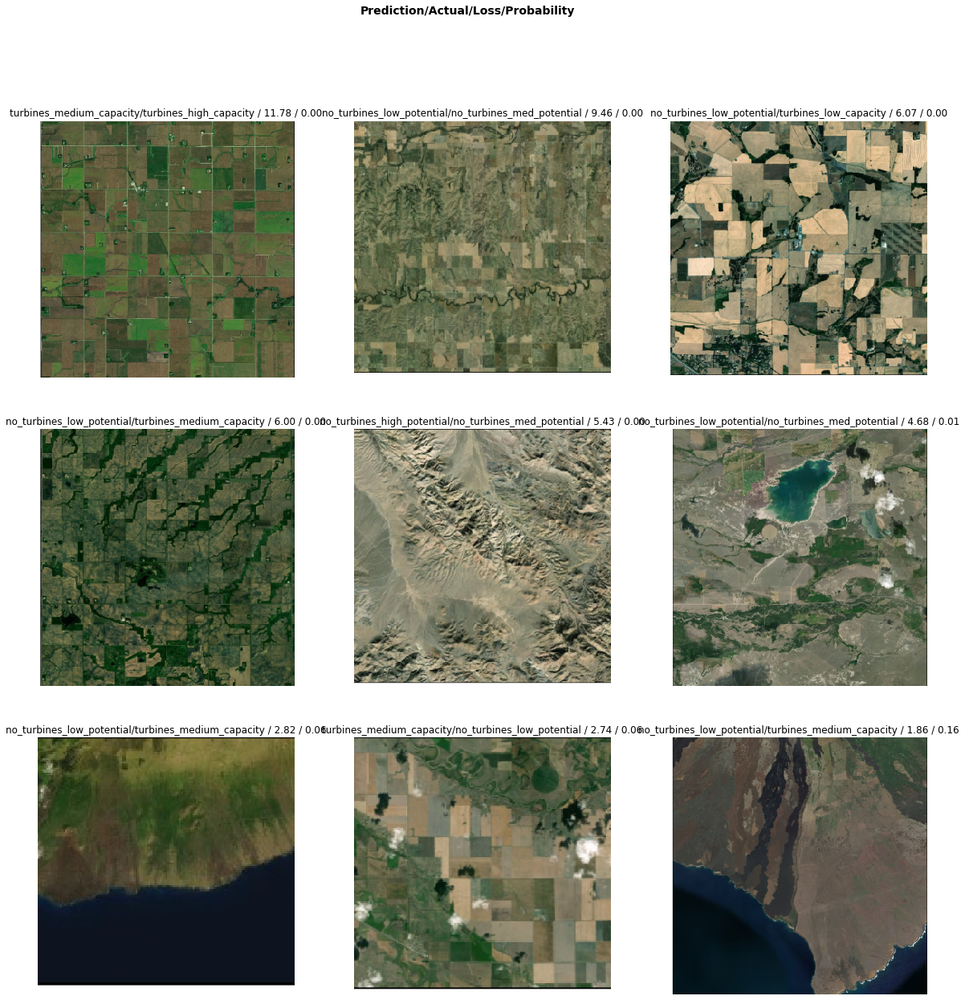

In [241]:
inc_interp7.plot_top_losses(9, heatmap=True, figsize=(20, 20))

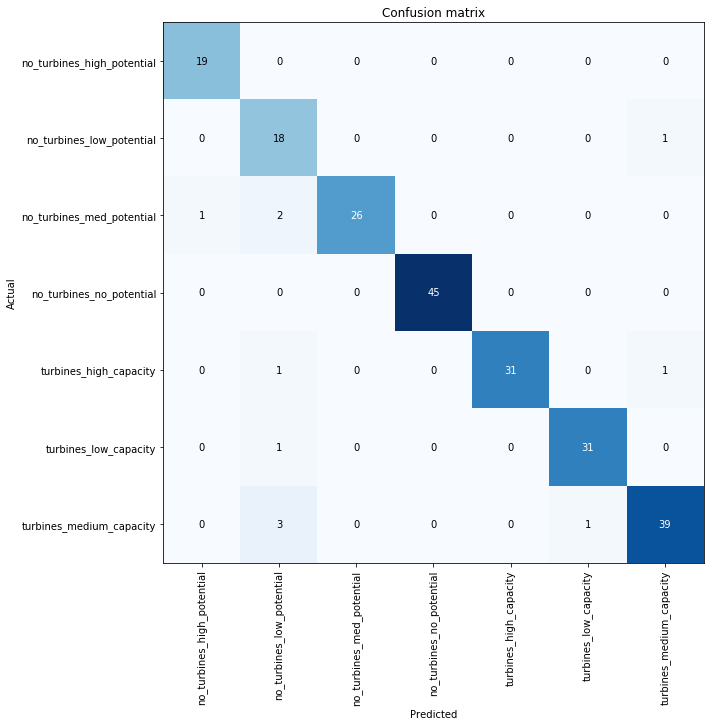

In [242]:
inc_interp7.plot_confusion_matrix(figsize=(10, 10))

In [243]:
gc.collect()

27848

#### **Stage 8:**

In [245]:
inc_learn.load('wfs-incept-phase8-h').unfreeze()
inc_learn.data = inc_data5
inc_learn.fit_one_cycle(1, (4e-3, 4e-3, 4e-3), wd=2e-2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,2.436196,743.122559,0.863636,0.136364,04:07


In [0]:
inc_preds8, inc_y8, inc_losses8 = inc_learn.get_preds(with_loss=True)
inc_interp8 = ClassificationInterpretation(inc_learn, inc_preds8, inc_y8, inc_losses8)

In [0]:
accuracy(*inc_learn.TTA())

tensor(0.2273)

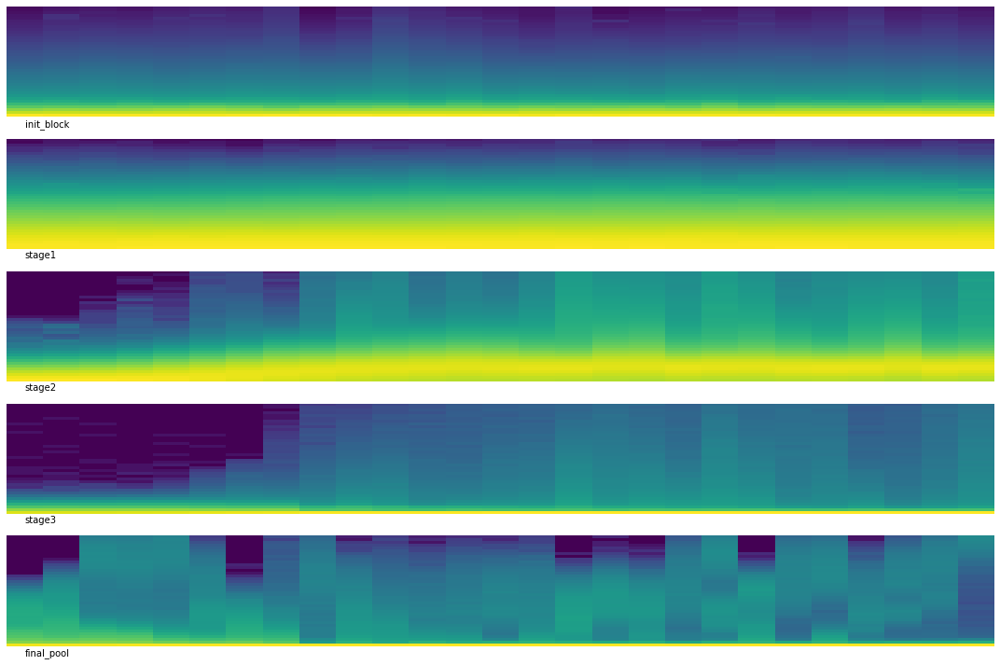

In [247]:
plot_activations(inc_hooks, inc_names, 4)

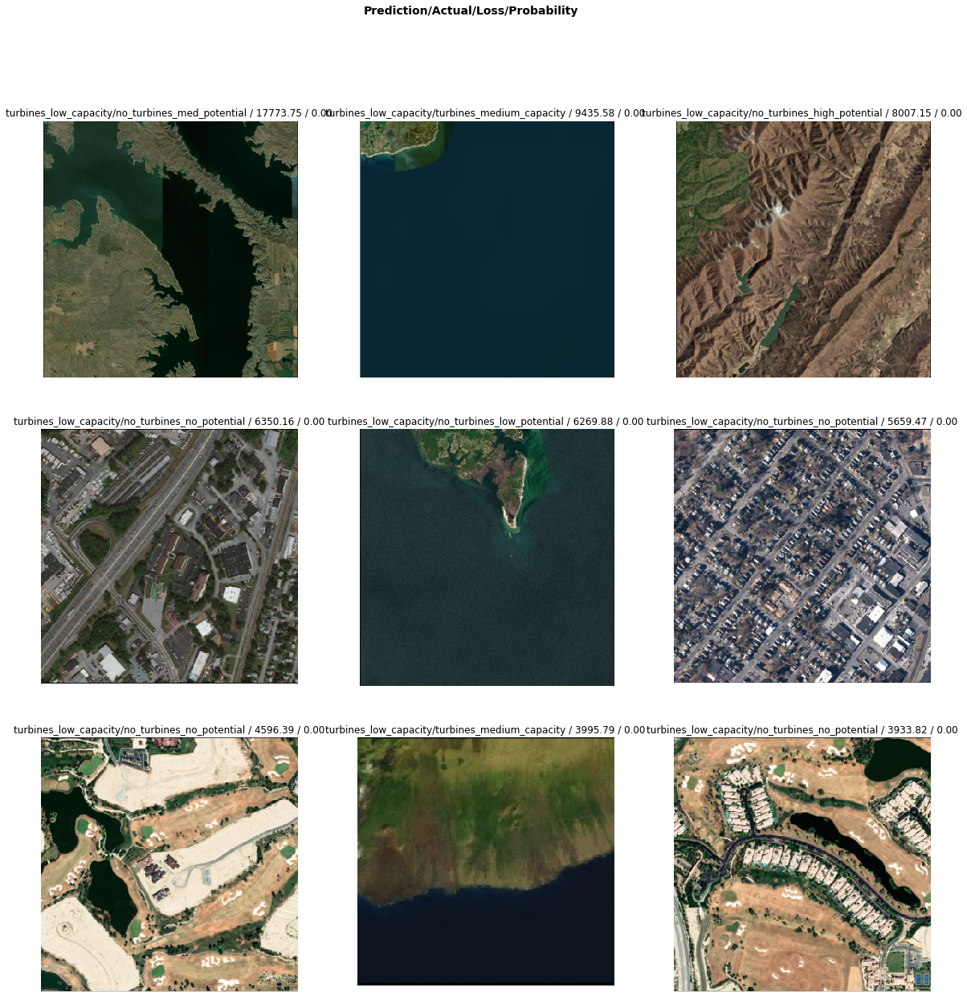

In [248]:
inc_interp8.plot_top_losses(9, heatmap=True, figsize=(20, 20))

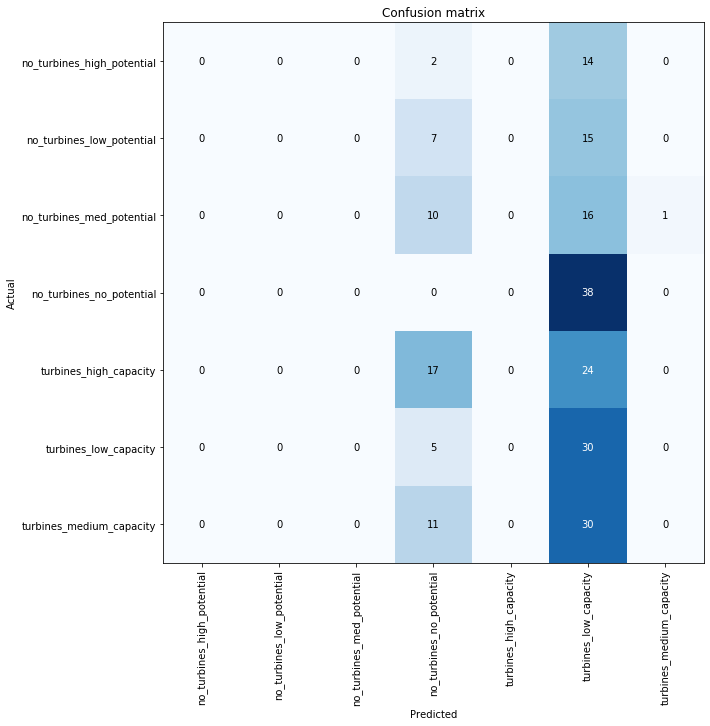

In [249]:
inc_interp8.plot_confusion_matrix(figsize=(10, 10))

In [250]:
gc.collect()

27848


### **Reflections**

